# AOPC

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import preprocessing
import pickle
def acquire_HAAS(x):
    dicts = {}
    files = []
    file_path = "dati/HAAS/"
    data = ["initial_conf", "conf_tot", "iou_tot"]
    for i in range(len(data)):
        files.append(file_path + "0" + str(x) + "_" + str(data[i]) + ".pkl")
    for i,file in enumerate(files):
        with open(file, 'rb') as dict:
            loaded_dict = pickle.load(dict)
            dicts[data[i]] = loaded_dict
    return dicts
def acquire_mean(x):
    dicts = {}
    files = []
    file_path = "dati/mean_trained/"
    data = ["initial_conf", "conf_tot", "iou_tot"]
    for i in range(len(data)):
        files.append(file_path + "0" + str(x) + "_" + str(data[i]) + ".pkl")
    for i,file in enumerate(files):
        with open(file, 'rb') as dict:
            loaded_dict = pickle.load(dict)
            dicts[data[i]] = loaded_dict
    return dicts
def acquire(x):
    dicts = {}
    files = []
    file_path = "dati/trained_model/"
    data = ["initial_conf", "conf_tot", "iou_tot"]
    for i in range(len(data)):
        files.append(file_path + "0" + str(x) + "_" + str(data[i]) + ".pkl")
    for i,file in enumerate(files):
        with open(file, 'rb') as dict:
            loaded_dict = pickle.load(dict)
            dicts[data[i]] = loaded_dict
    return dicts
def remove_none(dict):
    sub_dict = dict["initial_conf"]
    for key in sub_dict:
        if sub_dict[key] is None:
            sub_dict[key] = 0
    return sub_dict
def plot_dict(dict, cls):
    correct_dict = remove_none(dict)
    keys = range(len(list(correct_dict.keys())))
    values = list(correct_dict.values())
    plt.figure(figsize=(15, 10)) 

    plt.bar(keys, values)
    plt.xlabel('Keys')
    plt.ylabel('Confidence')
    plt.title('Confidence level for each image ' + cls)
    plt.show()
def sum_norm(dict):
    sum_values = []
    
    for index in range(len(next(iter(dict.values())))):
        index_sum = 0
        valid = True

        for key, value_list in dict.items():
            if not dict[key]:
                index_sum += 0
            else:
                index_sum += value_list[index]

        sum_values.append(index_sum)
    
    min_value = min(sum_values)
    max_value = max(sum_values)

    normalized_values = [(x - min_value) / (max_value - min_value) for x in sum_values]
    return normalized_values
def plot(dict, cls, flag):
    step = []
    conf = sum_norm(dict["conf_tot"])
    iou = sum_norm(dict["iou_tot"])
    baseline = baseline_conf(dict)
    for i in range(0, 101, 5):
        step.append(i)
    if flag:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7)) 
        ax1.plot(step, conf, label= "Confidence", marker='o', linestyle='-')
        ax1.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
        ax1.legend()
        ax1.grid(True)
        ax1.set_title("Confidence " + cls)
        ax2.plot(step, iou, label= "IoU",marker='o', linestyle='-')
        ax2.set_title("IoU " + cls)
        ax2.grid(True)
    else:
        plt.figure(figsize=(15, 10))  
        plt.plot(step, conf, label= "Confidence", marker='o', linestyle='-')
        plt.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
        plt.legend()
        plt.grid(True)
    plt.tight_layout()
    plt.show()
def find_min(dict):
    dict_correct = remove_none(dict)
    filtered_values = [value for value in dict_correct.values() if value != 0]
    if filtered_values:
        min_value = min(filtered_values)
        return [key for key, value in dict_correct.items() if value == min_value]
def sort_remove(dict):
    dict_correct = remove_none(dict)
    return {k: v for k, v in sorted(dict_correct.items(), key=lambda item: item[1]) if v != 0}
def plot_example(dict, ex):
    example_inital = dict["initial_conf"][ex]
    example = dict["conf_tot"][ex]
    for i in range(len(example)):
        if example[i] == -1:
            example[i] = 0
    conf_tot = [x - example_inital for x in example]
    steps = []
    for i in range(0, 101, 5):
        steps.append(i)
    plt.plot(steps, example, label = "Modified", marker='o', linestyle='-')
    plt.axhline(y=example_inital, color='r', linestyle='--', label='Baseline')
    print("Area Over the Perturbation Curve",sum(example) / len(steps))
    plt.legend()
    plt.xlabel('Pixel perturbation')
    plt.ylabel('Confidence')
    plt.title('Confidence vs. Pixel perturbation')
    plt.grid(True) 
    plt.show()
def baseline_conf(dict):
    dict_correct = remove_none(dict)
    return sum(dict_correct.values()) / len(dict_correct)

In [3]:
import random

def replacepixel(img, mask, percentile_value, task):
    mask = mask *255
    mask = mask.astype(np.uint8)
    image = Image.fromarray(img)
    mask = Image.fromarray(mask)
    # percentile_value = 100 - percentile_value
    mask_intensity = np.percentile(mask, percentile_value)
    # Get pixel access objects
    pixel_data = image.load()
    mask_data = mask.load()
    pixel_data = image.load()
    mask_data = mask.load()
    modified_mask = mask.copy()
    modified_mask_data = modified_mask.load()
    width, height = image.size
    mask_intensity_values = [(mask_r + mask_g + mask_b) / 3 for mask_r, mask_g, mask_b in mask.getdata()]
    if (task == 'mean'):
        mean_r = np.mean(img[:, :, 0])
        mean_g = np.mean(img[:, :, 1])
        mean_b = np.mean(img[:, :, 2])
    for x in range(width):
        for y in range(height):
            mask_intensity_value = mask_intensity_values[y * width + x]

            if mask_intensity_value <= mask_intensity:
                if(task == 'random'):
                    new_r = random.randint(0, 255)
                    new_g = random.randint(0, 255)
                    new_b = random.randint(0, 255)
                    modified_mask_data[x, y] = (new_r, new_g, new_b)
                    pixel_data[x, y] = (new_r, new_g, new_b) #random
                elif(task == 'mean'):
                    pixel_data[x, y] = (int(mean_r), int(mean_g), int(mean_b)) #mean
                elif(task == "remove"):
                    r, g, b = pixel_data[x, y]
                    mask_r, mask_g, mask_b = mask_data[x, y]
                    
                    new_r = r * (mask_r / 255) 
                    new_g = g * (mask_g / 255)  
                    new_b = b * (mask_b / 255)  
                    modified_mask_data[x, y] = (int(new_r), int(new_g), int(new_b))
                    pixel_data[x, y] = (int(new_r), int(new_g), int(new_b))

    # Convert the modified Pillow Image back to a numpy array
    modified_image = np.array(image)
    modified_mask = np.array(modified_mask)
    return modified_image, modified_mask

def perturbation(img, mask, percentile, task, bbox, cls):
    results = model(img, verbose=False, max_det=1)
    boxes = results[0].boxes
    original = results[0].plot()
    conf = float(boxes.conf.cpu().numpy())
    # data = results[0].boxes.data.cpu().numpy()
    # print(data)
    if(task == "remove"):
        perturbed = img * mask
        #perturbed, _ = replacepixel(img, mask, percentile, task)
    if(task == "mean"):
        perturbed, _ = replacepixel(img, mask, percentile, task)
    if(task == "random"):
        perturbed, _ = replacepixel(img, mask, percentile, task)
    results = model([perturbed], max_det=1, classes = cls)
    if len(results[0].boxes) != 0:
        iou = calculate_iou(bbox,results[0].boxes.xyxy[0].cpu().numpy())
        # data = results[0].boxes.data.cpu().numpy()
        # print(data)
        new = results[0].plot()
        boxes = results[0].boxes
        conf_incr =  float(boxes.conf.cpu().numpy())
        out = np.stack((original, new), axis=0) 
        return out, conf_incr, iou
    else:
        return None, None, None
    
def invert_grayscale_image(image):
    # Calculate the maximum pixel value for the grayscale image (usually 255 for 8-bit images)
    max_pixel_value = np.max(image)
    
    # Invert the image by subtracting each pixel value from the maximum
    inverted_image = max_pixel_value - image
    
    return inverted_image

In [ ]:
data = acquire(0)
import csv

conf = sum_norm(data["conf_tot"])
iou = sum_norm(data["iou_tot"])

# Specify the CSV file name
csv_file = 'd.csv'

# Open the CSV file in write mode
with open(csv_file, 'w', newline='') as csvfile:
    # Create a CSV writer object
    csv_writer = csv.writer(csvfile)

    # Write the header (keys of the dictionary) to the CSV file
    csv_writer.writerow(conf.keys())

    # Write the values of the dictionary to the CSV file
    for row in zip(*conf.values()):
        csv_writer.writerow(row)



In [ ]:
dict_conf = {
    "class0" : [],
    "class1" : [],
    "class2" : [],
    "class3" : [],
    "class4" : [],
    "class5" : []
}

In [18]:
conf

[0.9804500661145864,
 0.9941199790055426,
 1.0,
 0.9992748705356267,
 0.9949943569942271,
 0.987420706951767,
 0.9809057221944909,
 0.9861806487888769,
 0.9680704262762804,
 0.9591365803658486,
 0.9492755632713027,
 0.9597861096487829,
 0.9418083538930238,
 0.9052434400122521,
 0.778037489751075,
 0.6072923144042153,
 0.5309220633489022,
 0.49225288371241355,
 0.3613955979066122,
 0.08496541681977292,
 0.0]

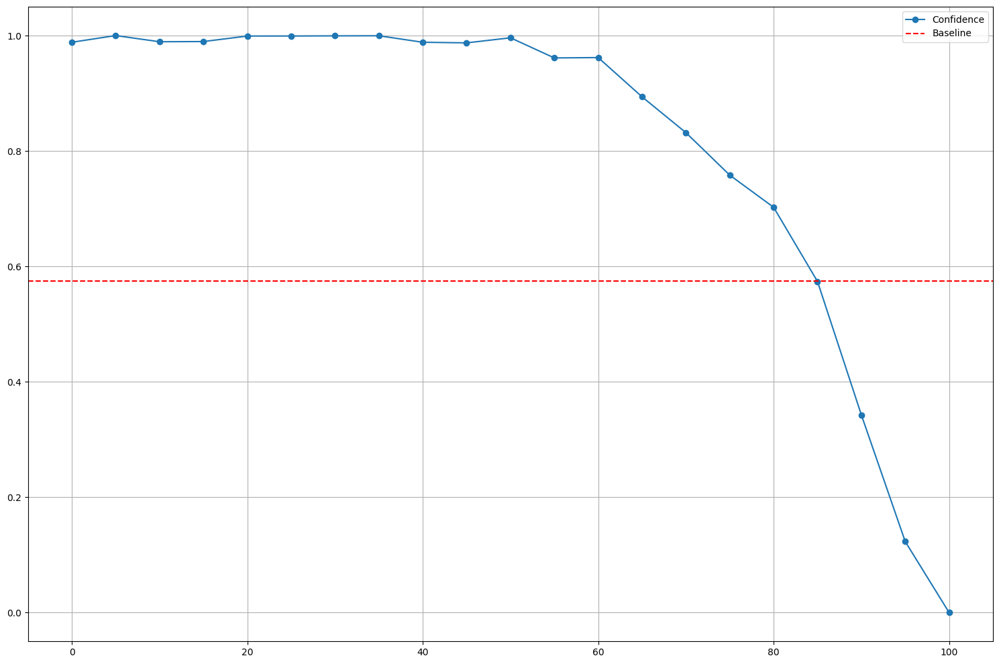

In [2]:
cls_1 = acquire(1)
plot(cls_1, "Class 1", False)

## Random Noise

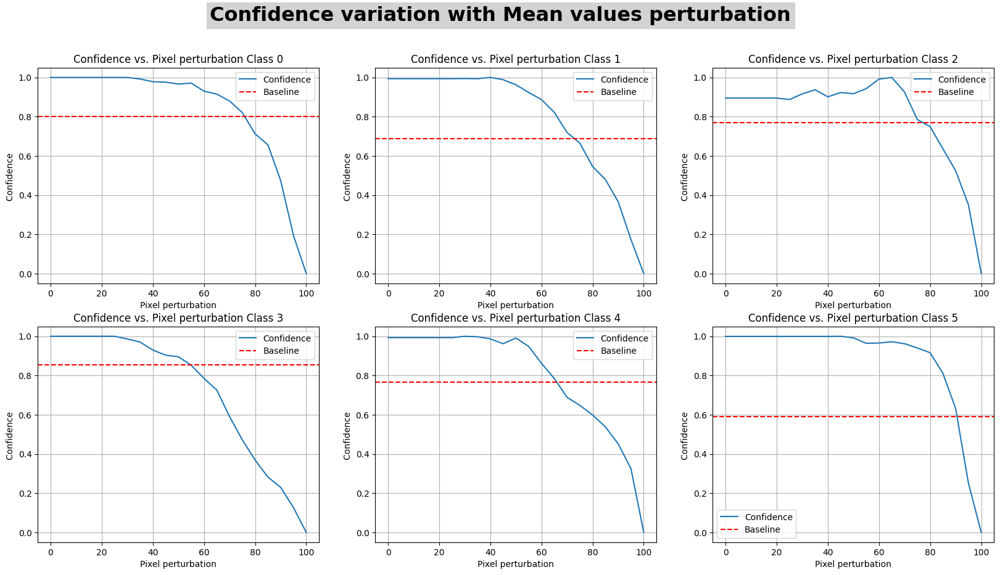

In [31]:
step = []
for u in range(0, 101, 5):
    step.append(u)

AOPC = []

plt.figure(figsize=(20, 10))
for i in range(6):
    x = i
    cls = acquire_mean(i)

    conf = sum_norm(cls["conf_tot"])
    initial_conf = cls["initial_conf"]
    iou = sum_norm(cls["iou_tot"])

    AOPC.append(sum(conf)/len(step))
    baseline = baseline_conf(cls)
    ax = plt.subplot(2, 3, i + 1)
    cla = "Class " + str(x)
    plt.plot(step,conf, label= "Confidence")
    plt.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
    plt.legend()
    plt.xlabel('Pixel perturbation')
    plt.ylabel('Confidence ')
    title = "Confidence vs. Pixel perturbation " + cla
    plt.title(title)
    plt.grid(True) 
    plt.axis("on")
    plt.suptitle('Confidence variation with Mean values perturbation', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()    

In [11]:
AOPC_rand

[0.7838825042855048,
 0.8135608180841064,
 0.793675164823104,
 0.741386155801462,
 0.8620260588292217,
 0.8576130894596548]

In [12]:
AOPC

[0.8316676697849219,
 0.7848550844473108,
 0.802875287311812,
 0.7198694715265779,
 0.7971847796407049,
 0.8761686142808262]

In [9]:
AOPC_rand = AOPC

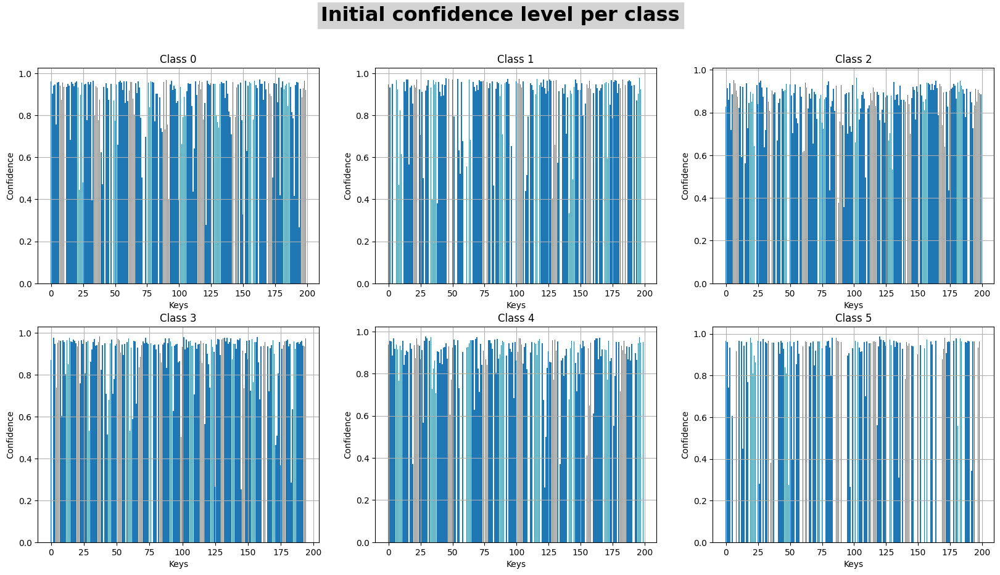

In [ ]:
plt.figure(figsize=(20, 10))
for i in range(6):
    x = i
    cls = acquire_mean(i)

    correct_dict = remove_none(cls)
    keys = range(len(list(correct_dict.keys())))
    values = list(correct_dict.values())




    ax = plt.subplot(2, 3, i + 1)
    cla = "Class " + str(x)
    plt.bar(keys, values)
    plt.xlabel('Keys')
    plt.ylabel('Confidence')
    plt.title('Confidence level for each image ' + cla)
    title = cla
    plt.title(title)
    plt.grid(True) 
    plt.axis("on")
    plt.suptitle('Initial confidence level per class', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()   

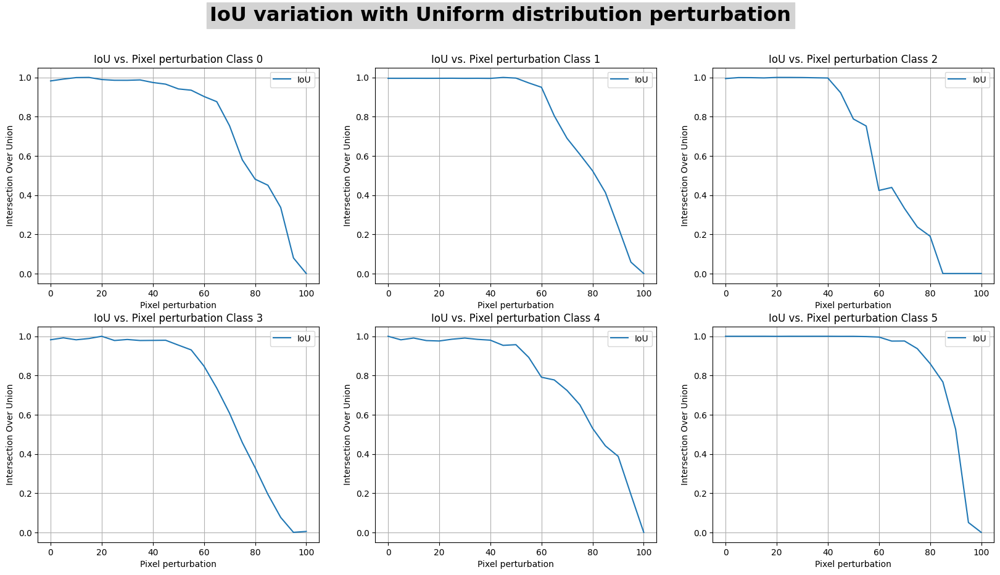

In [ ]:
step = []
for u in range(0, 101, 5):
    step.append(u)



plt.figure(figsize=(20, 10))
for i in range(6):
    x = i
    cls = acquire(i)

    conf = sum_norm(cls["conf_tot"])
    initial_conf = cls["initial_conf"]
    iou = sum_norm(cls["iou_tot"])
    baseline = baseline_conf(cls)
    ax = plt.subplot(2, 3, i + 1)
    cla = "Class " + str(x)
    plt.plot(step,iou, label= "IoU")
    #plt.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
    plt.legend()
    plt.xlabel('Pixel perturbation')
    plt.ylabel('Intersection Over Union')
    title = "IoU vs. Pixel perturbation " + cla
    plt.title(title)
    plt.grid(True) 
    plt.axis("on")
    plt.suptitle('IoU variation with Uniform distribution perturbation', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()    

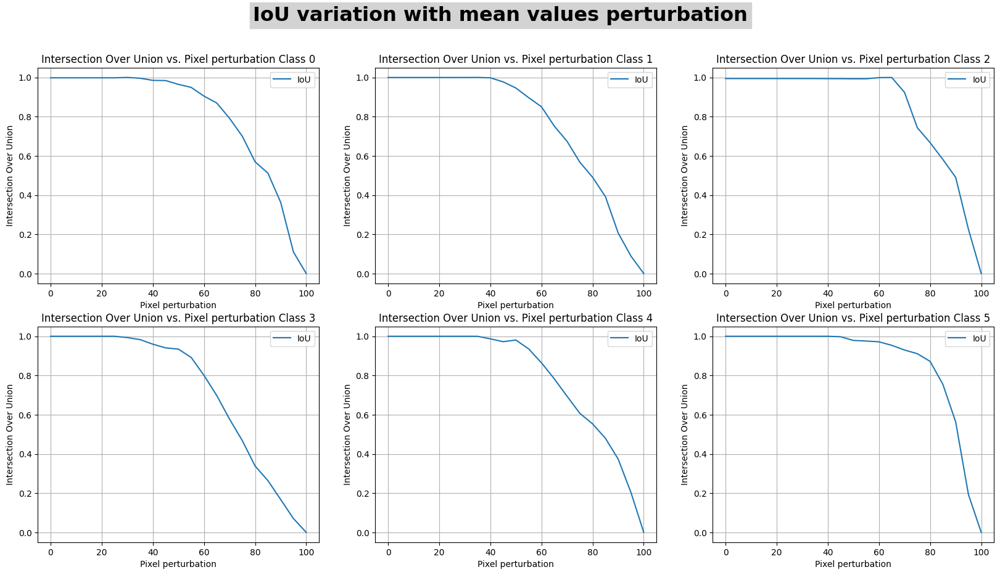

In [ ]:
plt.figure(figsize=(20, 10))
for i in range(6):
    x = i
    cls = acquire_mean(i)
    conf = sum_norm(cls["conf_tot"])
    iou = sum_norm(cls["iou_tot"])
    baseline = baseline_conf(cls)
    ax = plt.subplot(2, 3, i + 1)
    cla = "Class " + str(x)
    plt.plot(step,iou, label= "IoU")
    #plt.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
    plt.legend()
    plt.xlabel('Pixel perturbation')
    plt.ylabel('Intersection Over Union')
    title = "Intersection Over Union vs. Pixel perturbation " + cla
    plt.title(title)
    plt.grid(True) 
    plt.axis("on")
    plt.suptitle('IoU variation with mean values perturbation', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()    

In [ ]:
plt.figure(figsize=(20, 10))
for i in range(6):
    x = i
    cls = acquire_HAAS(i)
    conf = sum_norm(cls["conf_tot"])
    iou = sum_norm(cls["iou_tot"])
    baseline = baseline_conf(cls)
    ax = plt.subplot(2, 3, i + 1)
    cla = "Class " + str(x)
    plt.plot(step,conf, label= "Confidence")
    plt.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
    plt.legend()
    plt.xlabel('Pixel perturbation')
    plt.ylabel('Confidence')
    title = "Confidence vs. Pixel perturbation " + cla
    plt.title(title)
    plt.grid(True) 
    plt.axis("on")
    plt.suptitle('Confidence increase substituing with mean', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()    

TypeError: unsupported operand type(s) for +=: 'float' and 'NoneType'

<Figure size 2000x1000 with 0 Axes>

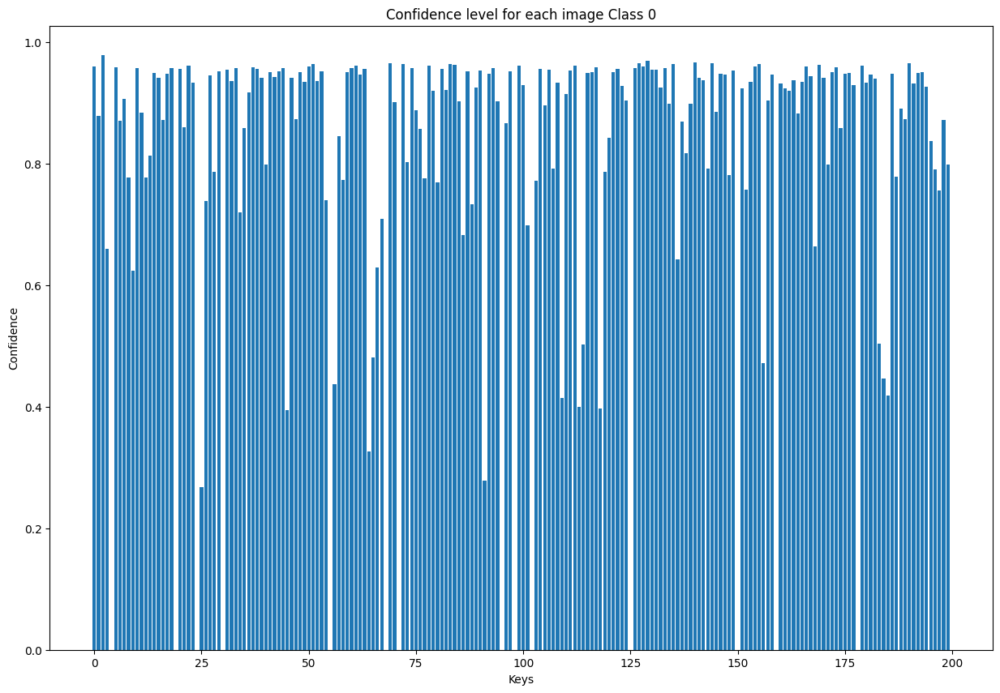

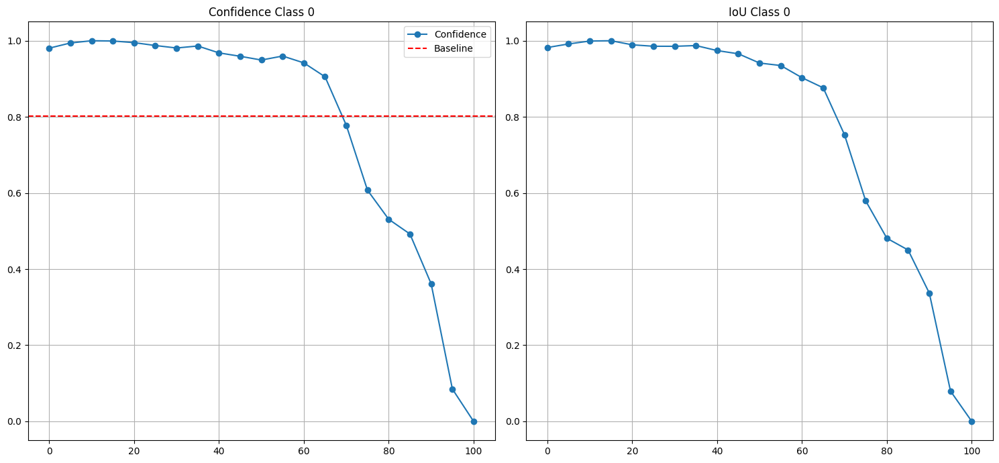

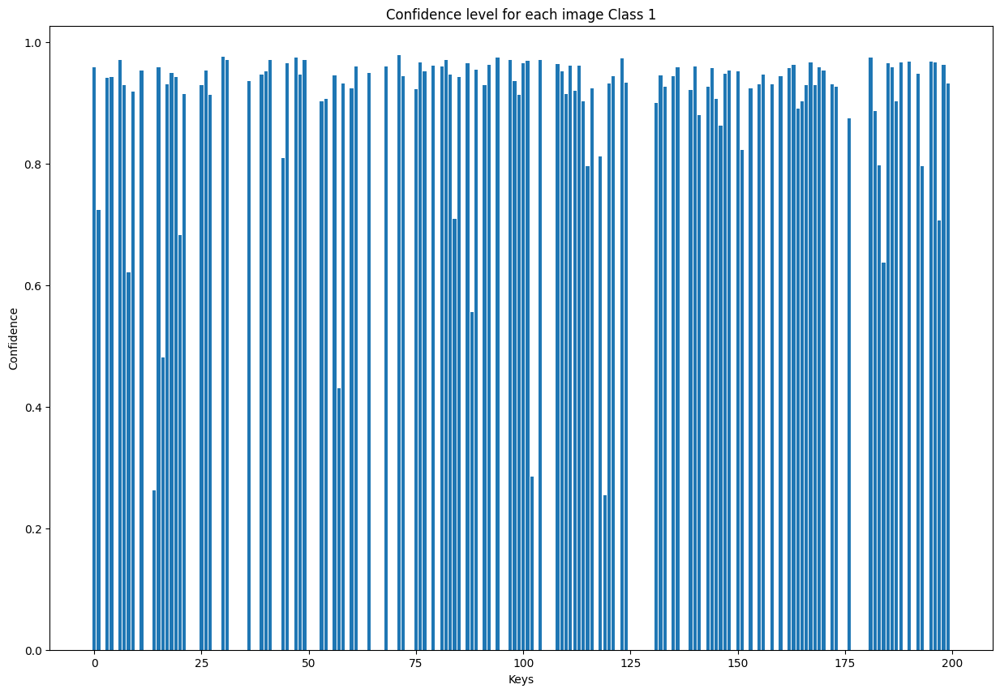

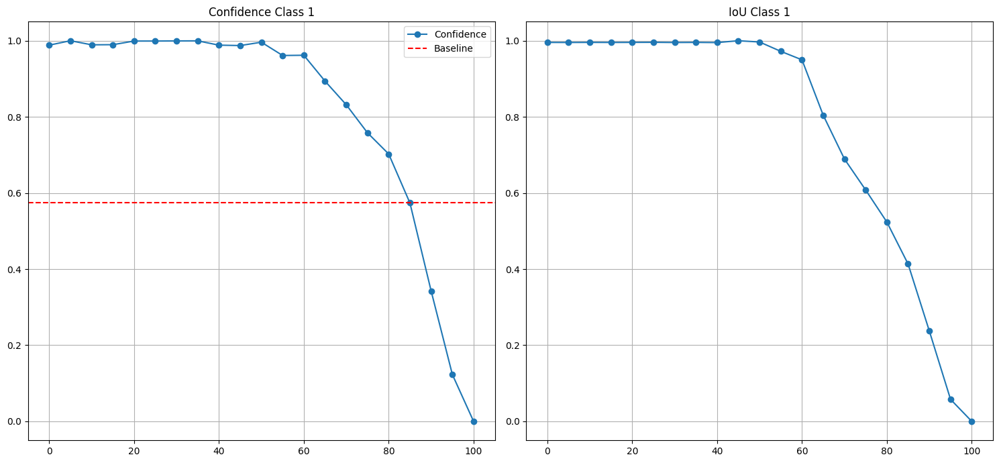

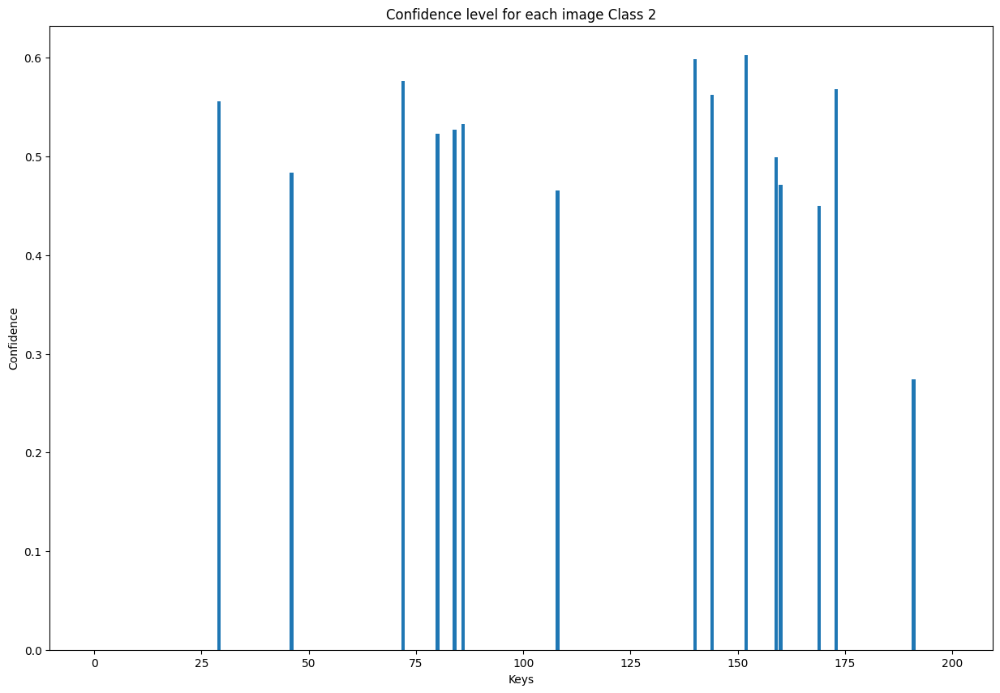

...

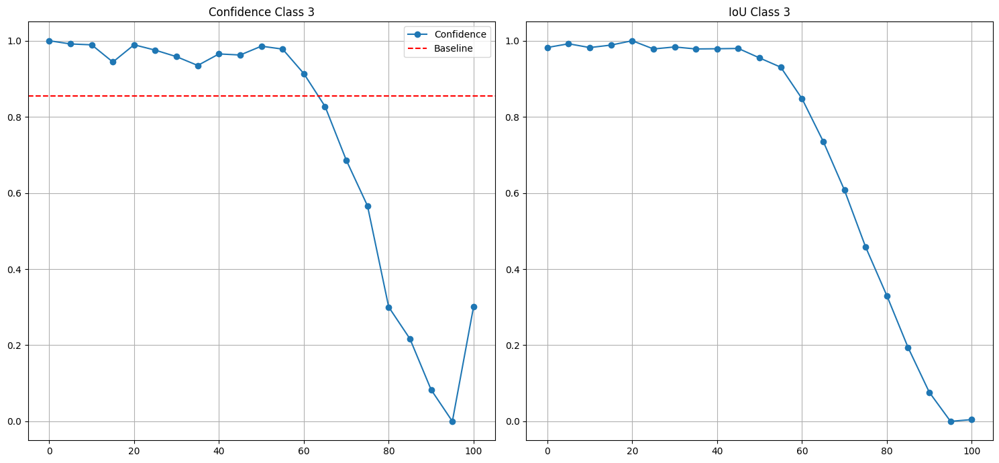

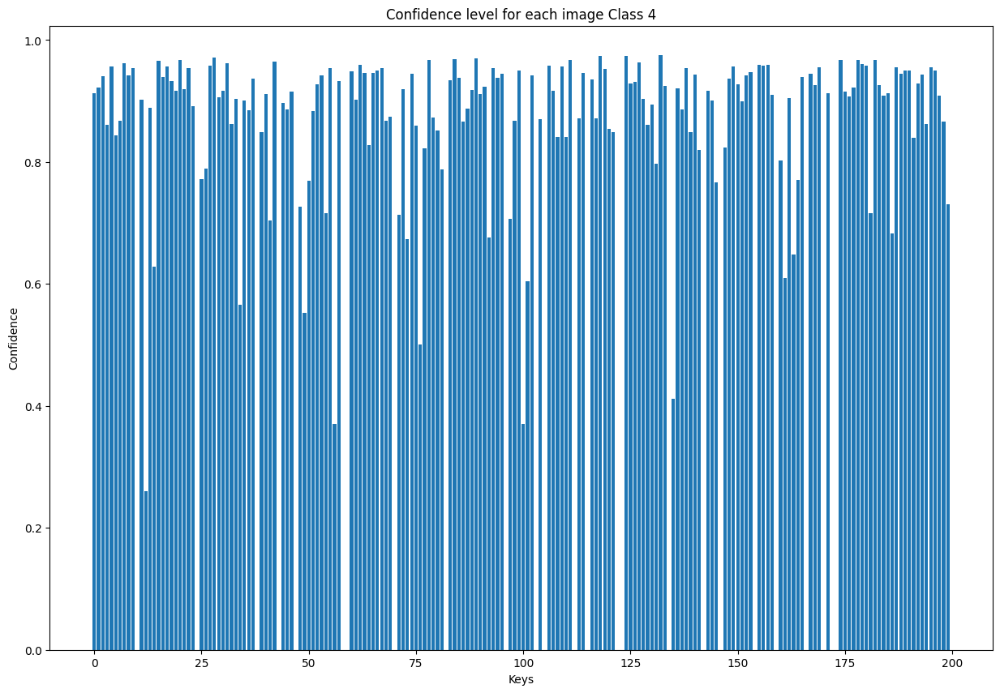

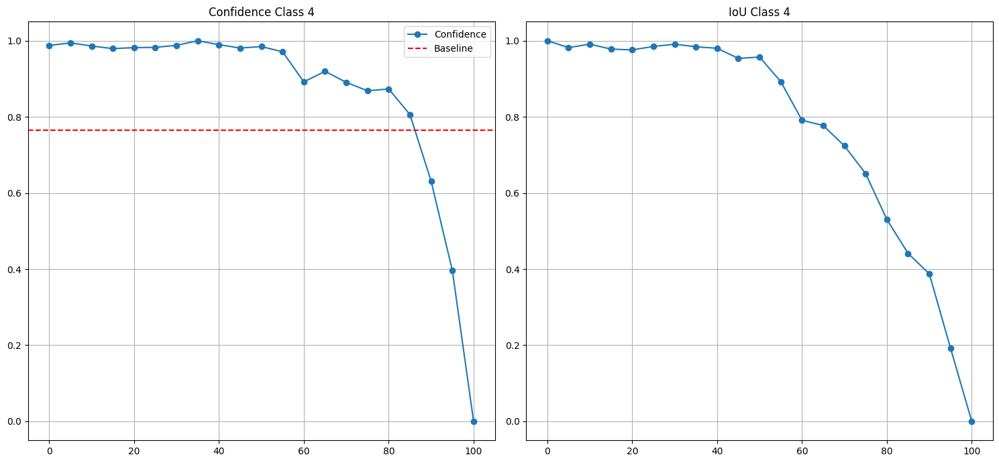

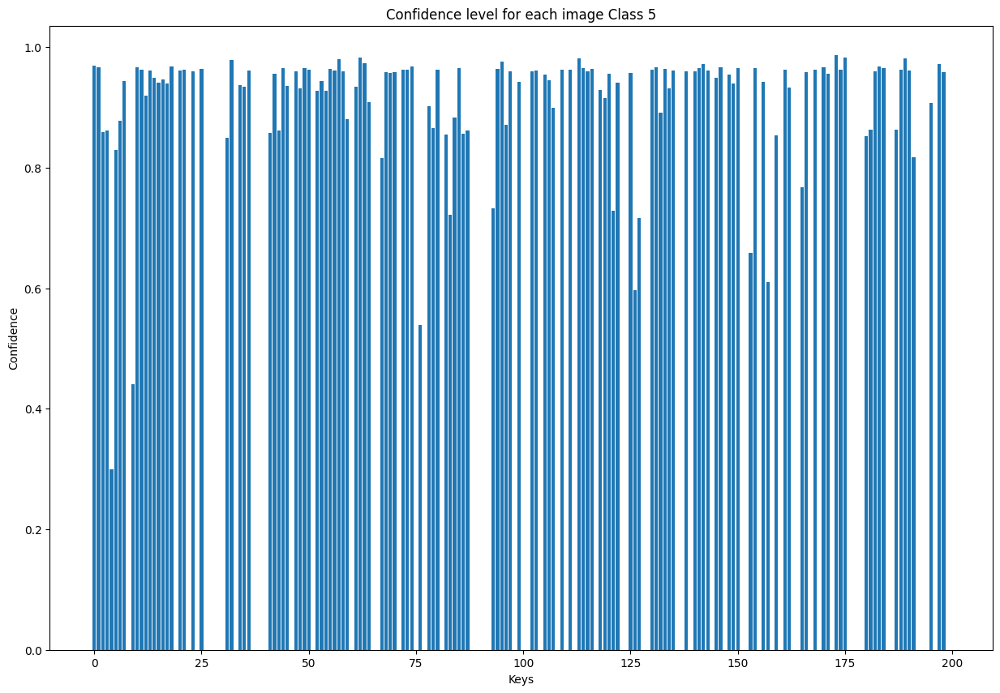

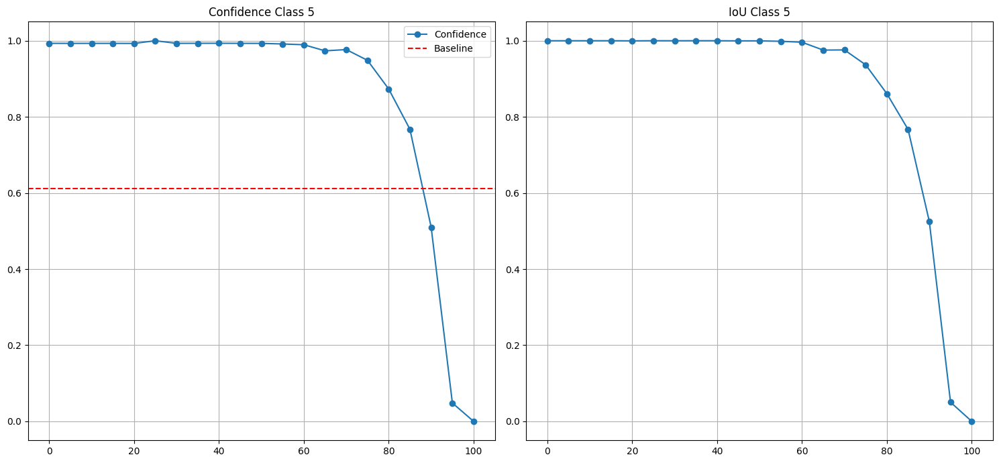

In [ ]:
for i in range(6):
    cls = acquire(i)
    plot_dict(cls, "Class " + str(i))
    plot(cls, "Class " + str(i), True)

## Mean

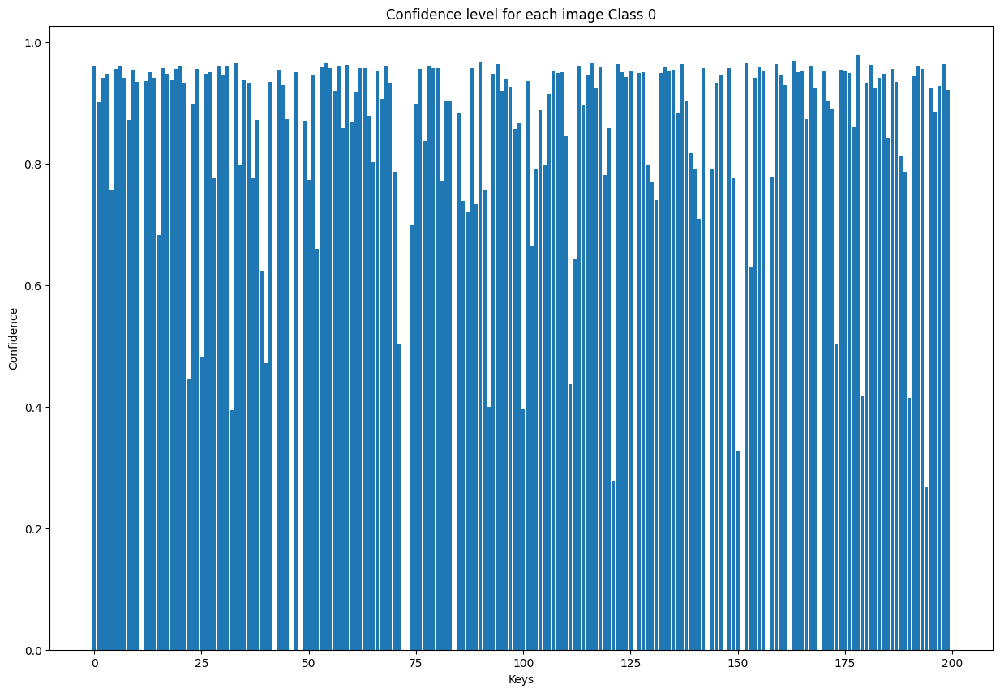

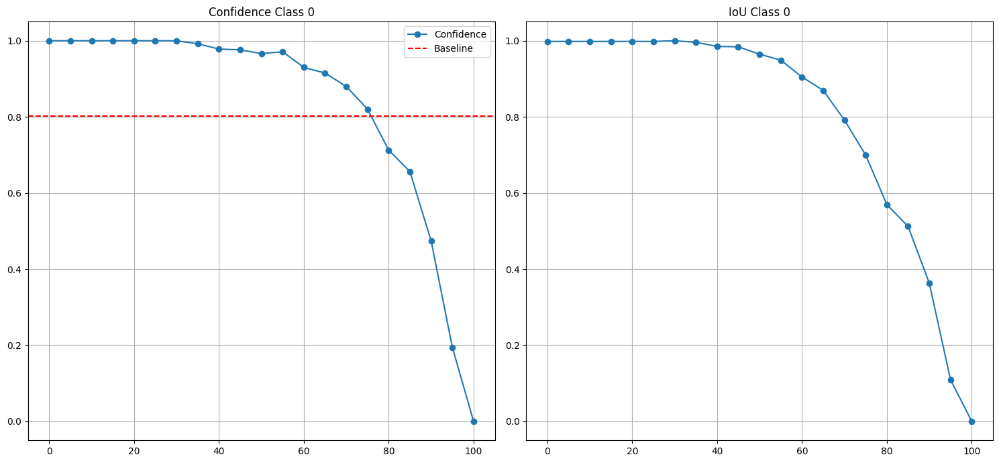

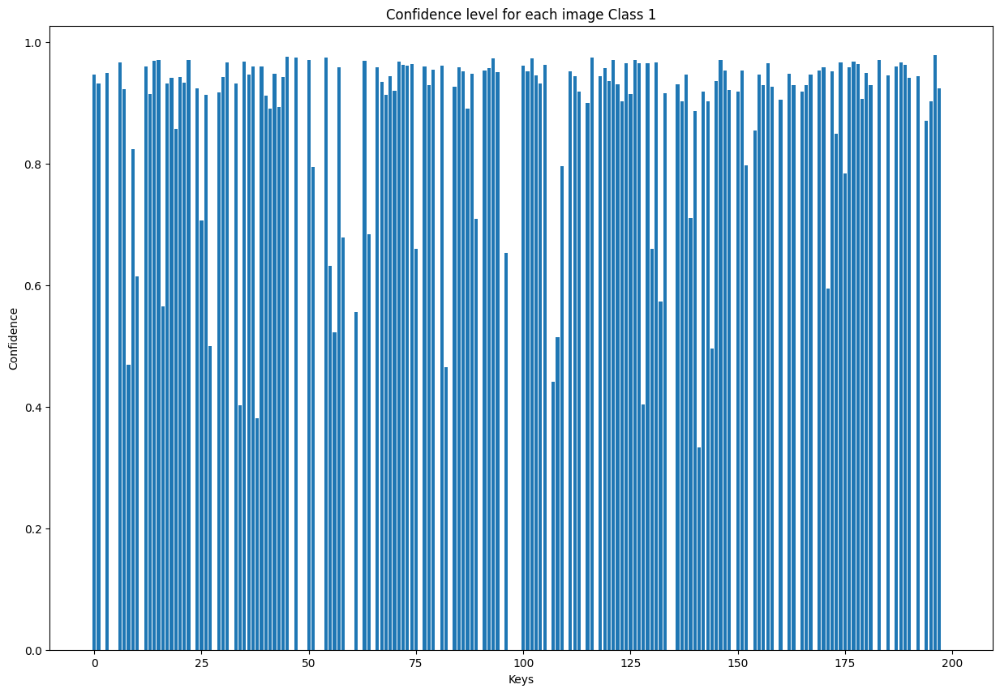

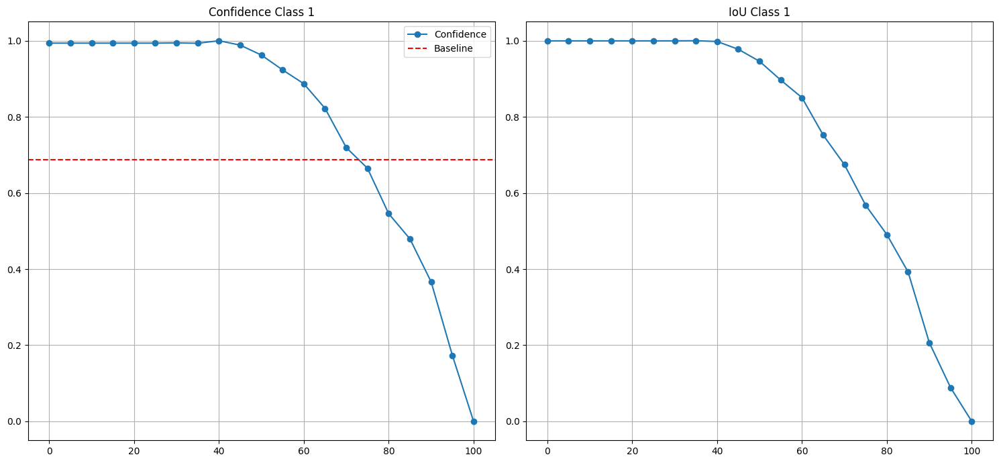

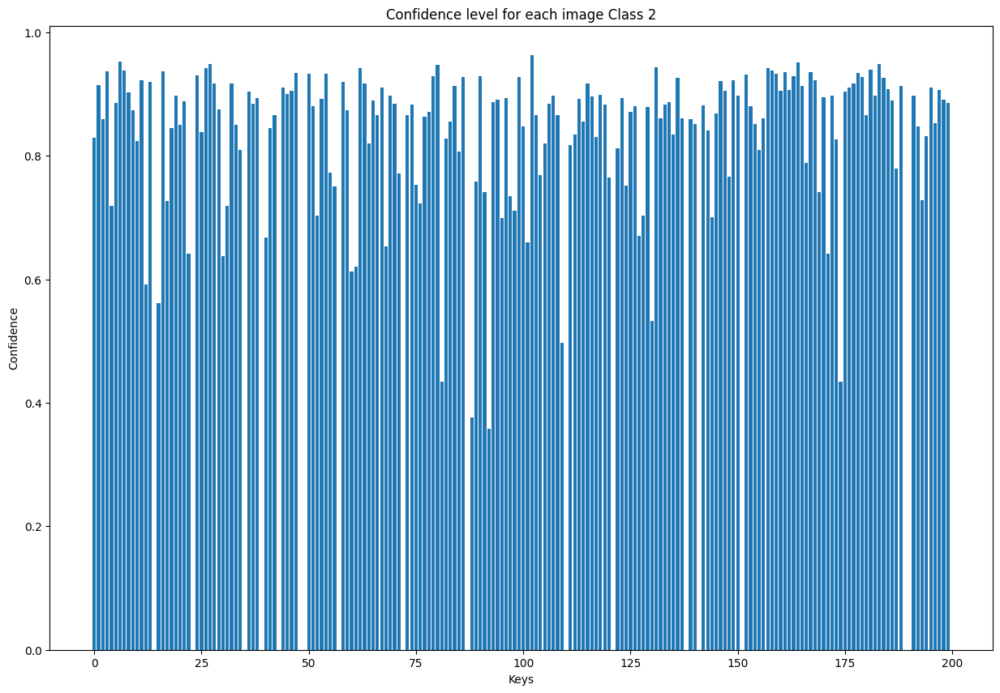

...

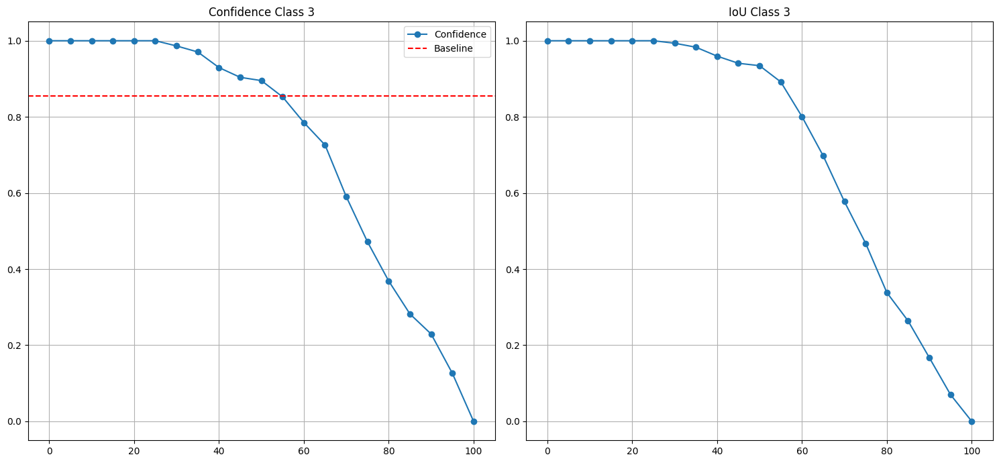

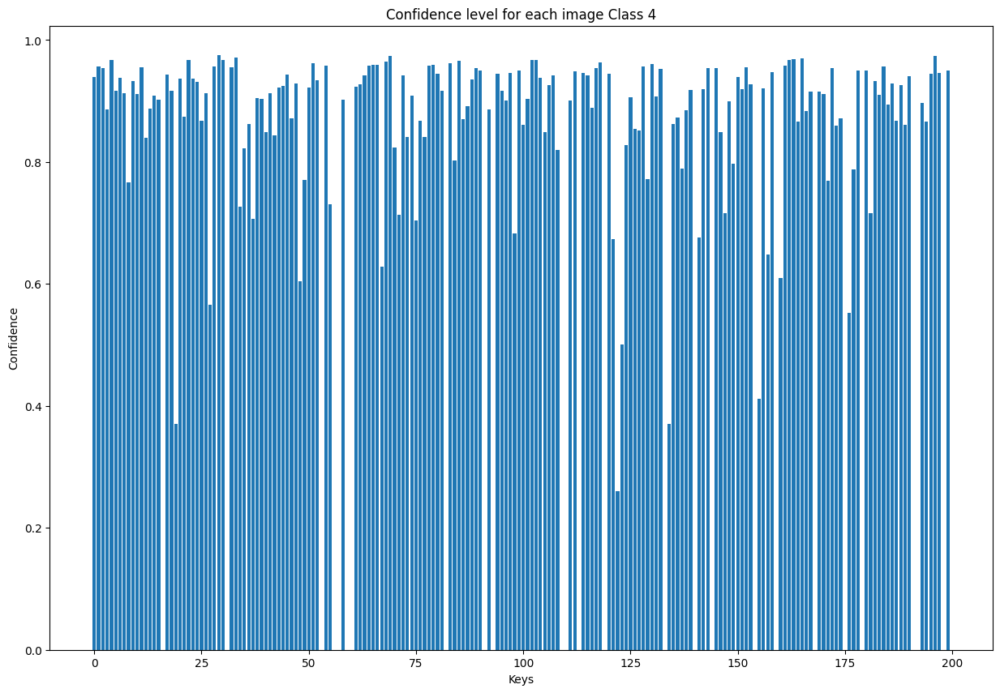

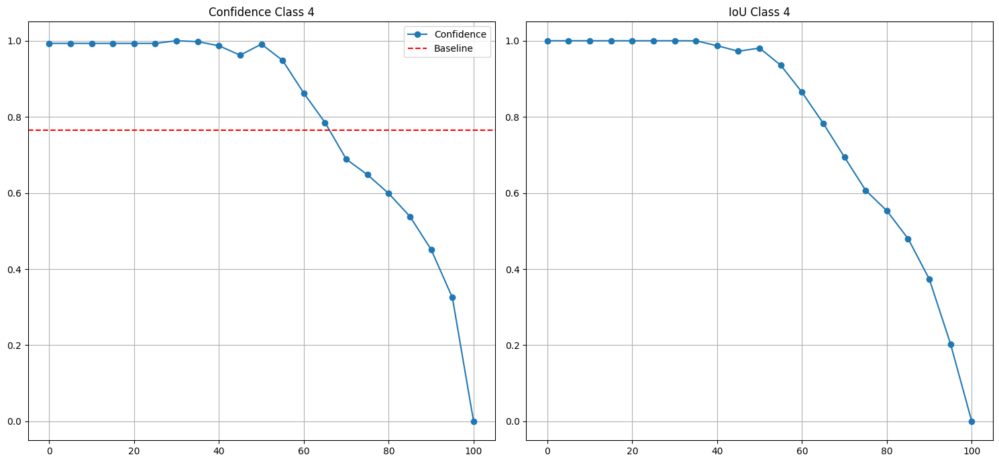

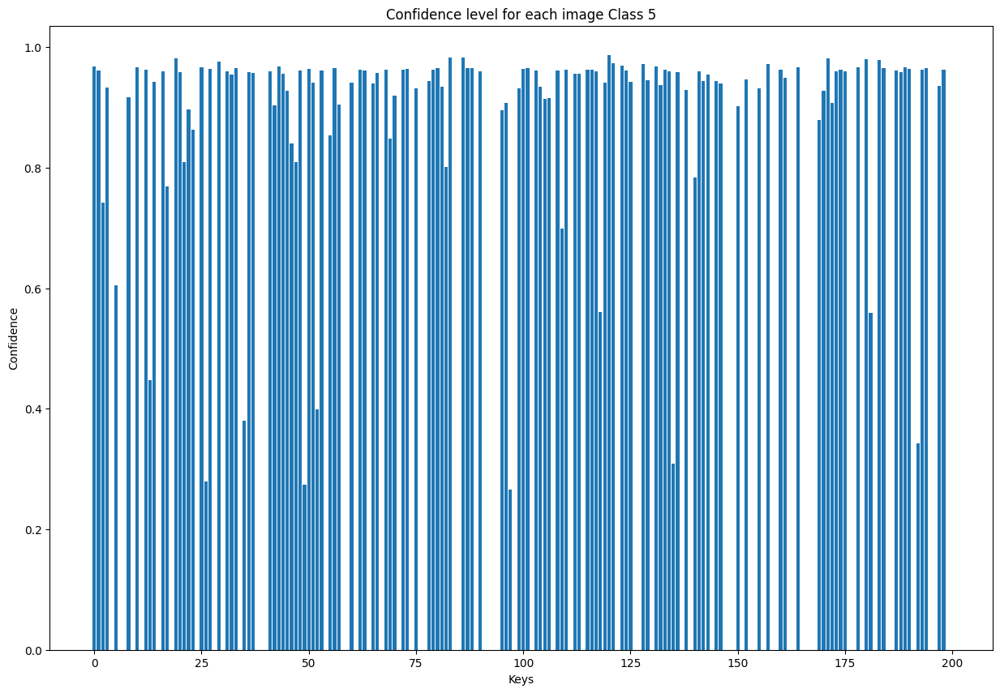

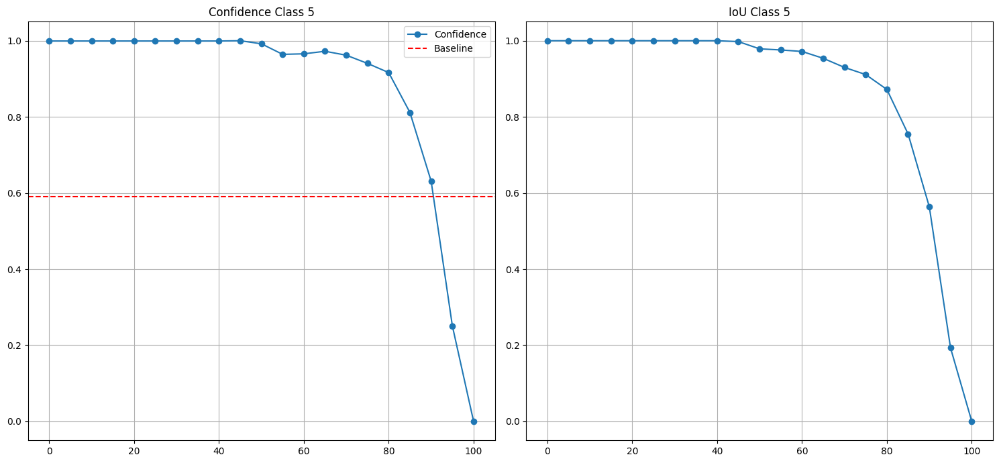

In [ ]:
for i in range(6):
    cls = acquire_mean(i)
    plot_dict(cls, "Class " + str(i))
    plot(cls, "Class " + str(i), True)

## Esempio Singola Immagine

In [5]:
dict = acquire(1)
dict_ferry = acquire(3)

In [6]:
sort_remove(dict_ferry)

{'17-05-2023_16-55-05_Cam1_396.jpg': 0.2532677948474884,
 '19-05-2023_20-39-59_Cam1_1519.jpg': 0.2643369436264038,
 '05-05-2023_11-09-45_Cam1_1768.jpg': 0.2847733199596405,
 '05-05-2023_11-09-45_Cam1_1592.jpg': 0.3665802478790283,
 '25-05-2023_12-03-36_Cam1_354.jpg': 0.46345284581184387,
 '22-04-2023_12-45-57_Cam1_1297.jpg': 0.5040398836135864,
 '17-05-2023_16-55-05_Cam1_1312.jpg': 0.5099930763244629,
 '19-05-2023_20-39-59_Cam1_990.jpg': 0.5157746076583862,
 '17-05-2023_10-14-34_Cam3_371.jpg': 0.5325318574905396,
 '17-05-2023_10-14-34_Cam3_335.jpg': 0.5337843298912048,
 '16-05-2023_13-52-59_Cam2_750.jpg': 0.5654319524765015,
 '05-05-2023_11-09-45_Cam1_1854.jpg': 0.5879666805267334,
 '22-04-2023_12-45-57_Cam1_238.jpg': 0.603169858455658,
 '23-05-2023_09-35-09_Cam1_402.jpg': 0.6252732872962952,
 '17-05-2023_16-55-05_Cam1_1013.jpg': 0.6355029344558716,
 '19-05-2023_20-39-59_Cam1_980.jpg': 0.6609423756599426,
 '22-04-2023_12-45-57_Cam1_1987.jpg': 0.6794404983520508,
 '29-04-2023_12-07-36_C

In [7]:
dict_ferry["conf_tot"]['23-05-2023_09-35-09_Cam1_285.jpg']

[0.8763478994369507,
 0.912409782409668,
 0.8632965683937073,
 0.8896235227584839,
 0.8484069108963013,
 0.808731198310852,
 0.8431172966957092,
 0.8471870422363281,
 0.9004462957382202,
 0.869486927986145,
 0.830962061882019,
 0.87532639503479,
 0.8485909700393677,
 0.8494554758071899,
 0.8888188004493713,
 0.8921368718147278,
 0.8909125328063965,
 0.842698335647583,
 0.7691864371299744,
 0.7215731739997864,
 0.6299450397491455]

Area Over the Perturbation Curve 0.842793311391558
Area Over the Perturbation Curve 0.842793311391558


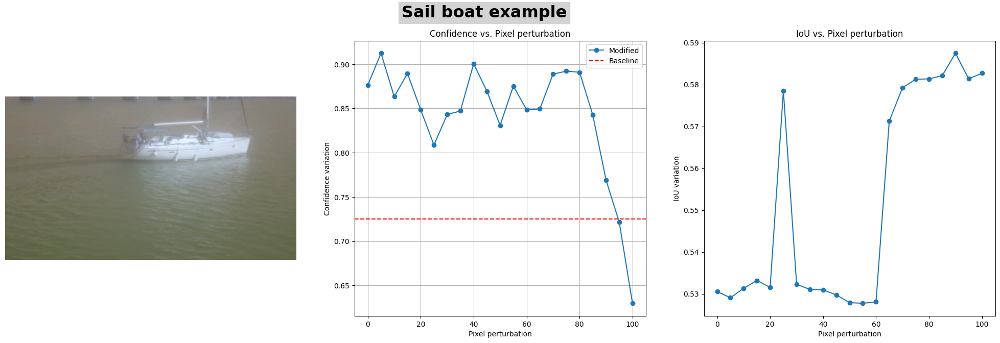

In [8]:
import cv2

example_inital = dict_ferry["initial_conf"]['23-05-2023_09-35-09_Cam1_285.jpg']
example = dict_ferry["conf_tot"]['23-05-2023_09-35-09_Cam1_285.jpg']
iou = dict_ferry["iou_tot"]['23-05-2023_09-35-09_Cam1_285.jpg']
for i in range(len(example)):
    if example[i] == -1:
        example[i] = 0
conf_tot = [x - example_inital for x in example]
steps = []
for i in range(0, 101, 5):
    steps.append(i)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(25, 7)) 
img = cv2.imread("utils/dataset/subset/03_SailBoat/23-05-2023_09-35-09_Cam1_285.jpg")
ax1.imshow(img)

ax2.plot(steps, example, label = "Modified", marker='o', linestyle='-')
ax2.axhline(y=example_inital, color='r', linestyle='--', label='Baseline')
print("Area Over the Perturbation Curve",sum(example) / len(steps))
ax2.legend()
ax2.set_xlabel('Pixel perturbation')
ax2.set_ylabel('Confidence variation')
title = "Confidence vs. Pixel perturbation"
ax2.set_title(title)
ax1.grid(False)
ax1.axis("off")
ax2.grid(True)  

ax3.plot(steps, iou, label = "Modified", marker='o', linestyle='-')

ax3.set_xlabel('Pixel perturbation')
ax3.set_ylabel('IoU variation')
title = "IoU vs. Pixel perturbation"
ax3.set_title(title)
print("Area Over the Perturbation Curve",sum(example) / len(steps))
ax2.legend()


plt.suptitle('Sail boat example', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()


Area Over the Perturbation Curve 0.6806833162194207
Area Over the Perturbation Curve 0.6806833162194207


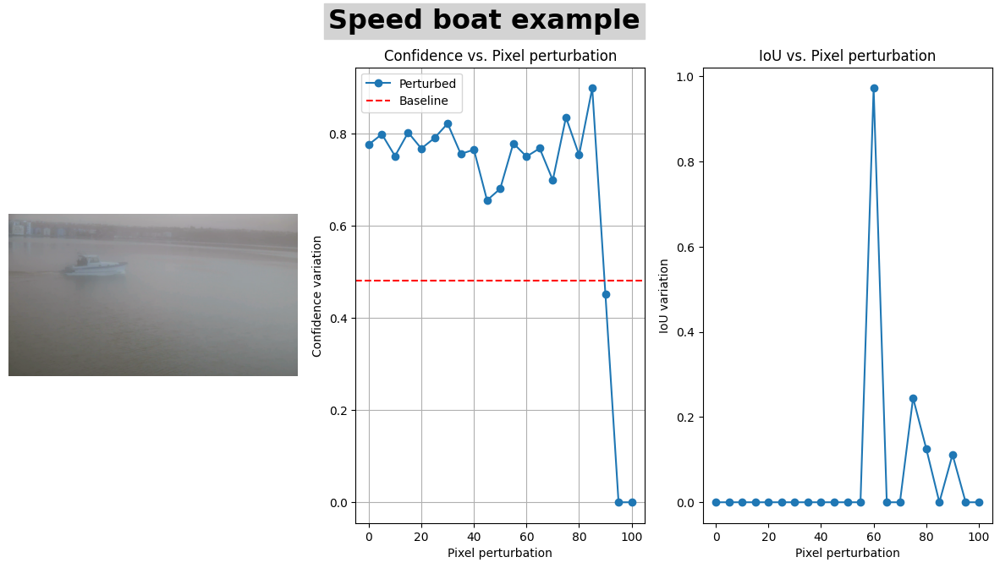

In [9]:
example_inital = dict["initial_conf"]['20-04-2023_11-11-57_Cam2_76.jpg']
example = dict["conf_tot"]['20-04-2023_11-11-57_Cam2_76.jpg']
iou = dict["iou_tot"]['20-04-2023_11-11-57_Cam2_76.jpg']
for i in range(len(example)):
    if example[i] == -1:
        example[i] = 0
conf_tot = [x - example_inital for x in example]
steps = []
for i in range(0, 101, 5):
    steps.append(i)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 7)) 
img = cv2.imread("utils/dataset/subset/01_SpeedBoat/20-04-2023_11-11-57_Cam2_76.jpg")
ax1.imshow(img)

ax2.plot(steps, example, label = "Perturbed", marker='o', linestyle='-')
ax2.axhline(y=example_inital, color='r', linestyle='--', label='Baseline')

ax2.set_xlabel('Pixel perturbation')
ax2.set_ylabel('Confidence variation')
title = "Confidence vs. Pixel perturbation"
ax2.set_title(title)
print("Area Over the Perturbation Curve",sum(example) / len(steps))
ax2.legend()


ax3.plot(steps, iou, label = "Modified", marker='o', linestyle='-')

ax3.set_xlabel('Pixel perturbation')
ax3.set_ylabel('IoU variation')
title = "IoU vs. Pixel perturbation"
ax3.set_title(title)
print("Area Over the Perturbation Curve",sum(example) / len(steps))
ax2.legend()


ax1.grid(False)
ax1.axis("off")
ax2.grid(True)  
plt.suptitle('Speed boat example', fontsize=23, fontweight='bold', backgroundcolor='lightgray')

plt.show()

In [10]:
image_path = "utils/dataset/subset/03_SailBoat/16-05-2023_13-52-59_Cam2_750.jpg"


speed_path = "utils/dataset/subset/01_SpeedBoat/20-04-2023_11-11-57_Cam2_76.jpg"

In [11]:
dict["initial_conf"]['20-04-2023_11-11-57_Cam1_173.jpg']

0.2536807656288147

In [12]:
dict["conf_tot"]['26-05-2023_16-04-04_Cam2_2967.jpg']

KeyError: '26-05-2023_16-04-04_Cam2_2967.jpg'


0: 640x640 1 Ferry Boat, 55.4ms
Speed: 8.3ms preprocess, 55.4ms inference, 36.0ms postprocess per image at shape (1, 3, 640, 640)


[     0.9456]


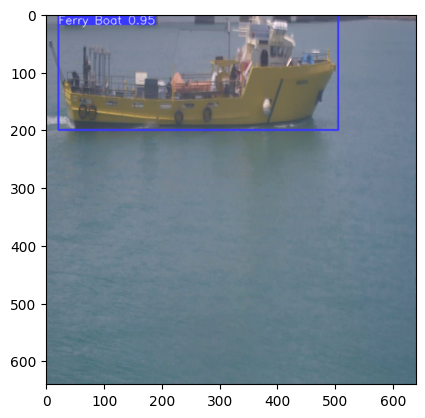

In [4]:
import cv2
from PIL import Image
from ultralytics import YOLO
image_path = "utils/images/ferry.png"
img = np.array(Image.open(image_path))
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = img.astype(np.float32) / 255.0
model = YOLO("models/VisibleModel/weights/best.pt")

COLORS = np.random.uniform(0, 255, size=(len(model.names), 3))
results = model(rgb_img, verbose=True)
print(results[0].boxes.conf.cpu().numpy())
plt.imshow(results[0].plot())


0: 640x640 1 Ferry Boat, 56.2ms
Speed: 3.7ms preprocess, 56.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


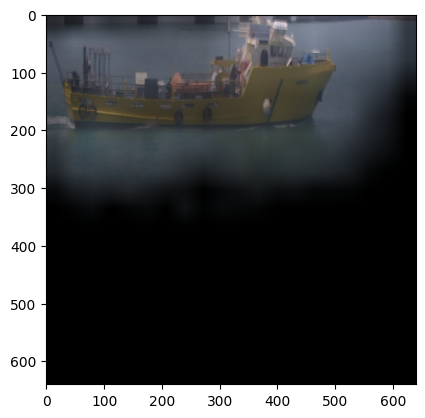

In [5]:
from yolo_cam.eigen_cam import EigenCAM

target_layers = [model.model.model[-3]]
cam = EigenCAM(model, target_layers)
grayscale_cam = cam(rgb_img)[0, :, :]
g_scale = np.stack([grayscale_cam] * 3, axis=2)
plt.imshow(g_scale/255*rgb_img)


0: 640x640 1 Ferry Boat, 55.6ms
Speed: 23.3ms preprocess, 55.6ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


0


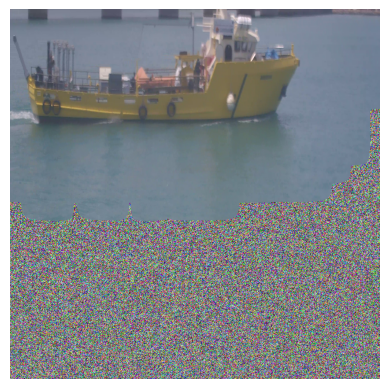


0: 640x640 1 Ferry Boat, 55.9ms
Speed: 3.5ms preprocess, 55.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


5


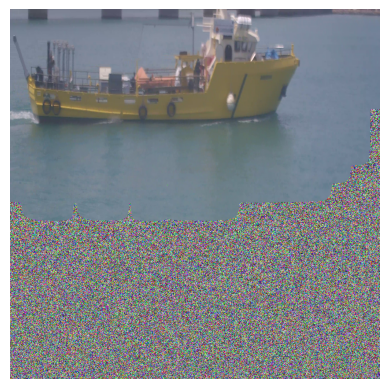


0: 640x640 1 Ferry Boat, 56.1ms
Speed: 3.3ms preprocess, 56.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


10


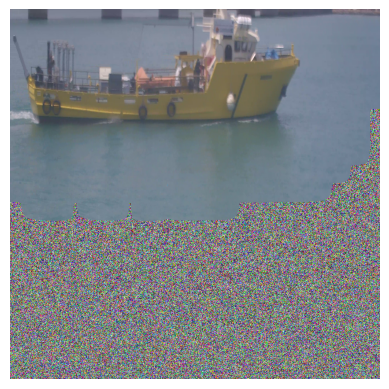


0: 640x640 1 Ferry Boat, 56.2ms
Speed: 3.2ms preprocess, 56.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


15


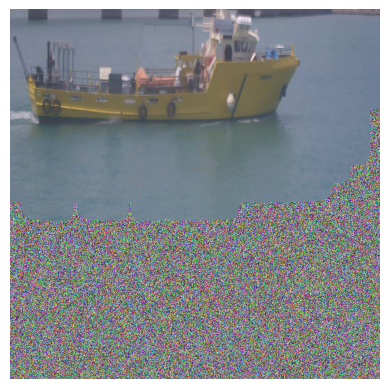


0: 640x640 1 Ferry Boat, 56.5ms
Speed: 3.2ms preprocess, 56.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


20


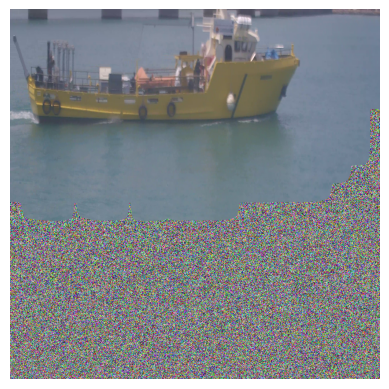


0: 640x640 1 Ferry Boat, 56.1ms
Speed: 3.1ms preprocess, 56.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


25


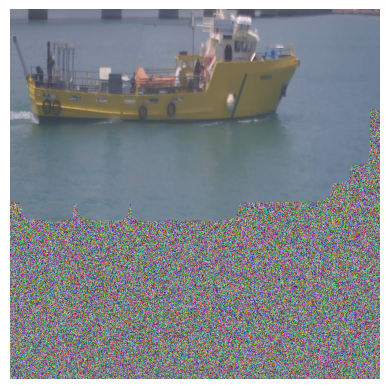


0: 640x640 1 Ferry Boat, 56.6ms
Speed: 4.0ms preprocess, 56.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


30


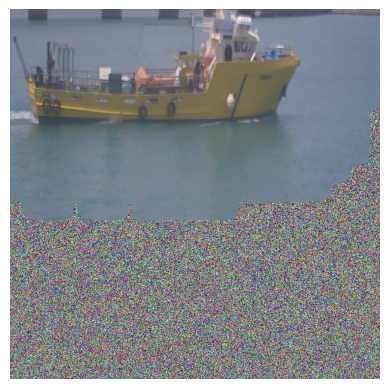


0: 640x640 1 Ferry Boat, 56.0ms
Speed: 3.3ms preprocess, 56.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


35


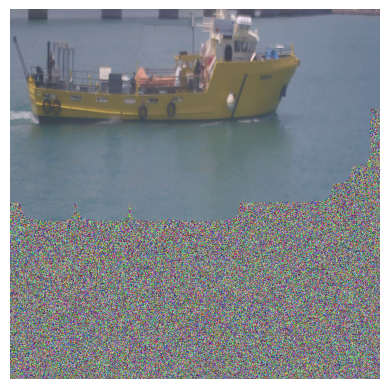


0: 640x640 1 Ferry Boat, 56.4ms
Speed: 3.3ms preprocess, 56.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


40


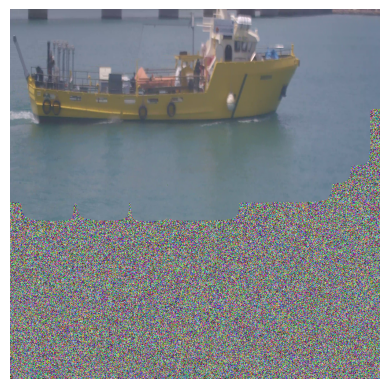


0: 640x640 1 Ferry Boat, 56.0ms
Speed: 3.2ms preprocess, 56.0ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


45


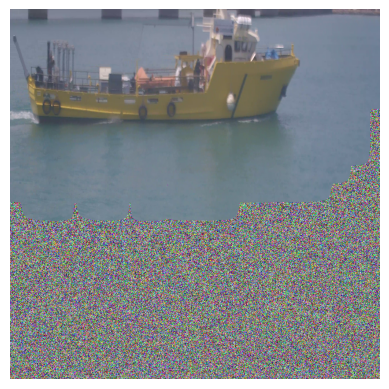


0: 640x640 1 Ferry Boat, 56.1ms
Speed: 3.3ms preprocess, 56.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


50


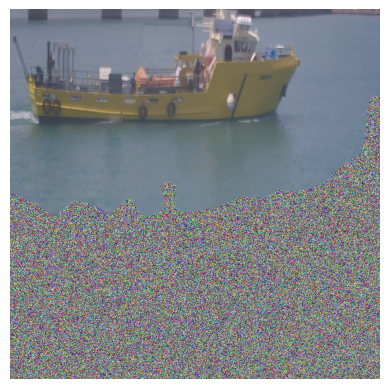


0: 640x640 1 Ferry Boat, 55.9ms
Speed: 3.2ms preprocess, 55.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


55


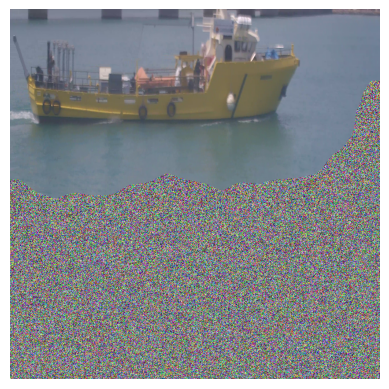


0: 640x640 1 Ferry Boat, 56.3ms
Speed: 3.3ms preprocess, 56.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


60


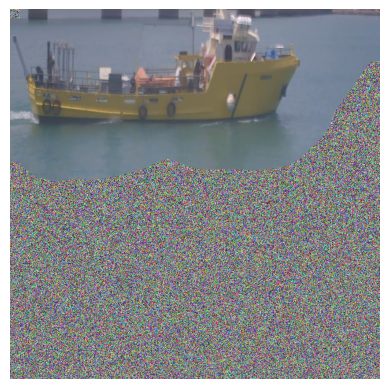


0: 640x640 1 Ferry Boat, 55.6ms
Speed: 3.1ms preprocess, 55.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


65


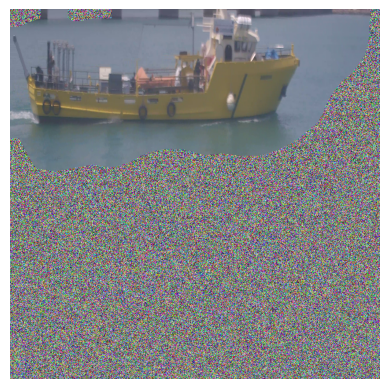


0: 640x640 1 Ferry Boat, 56.2ms
Speed: 3.2ms preprocess, 56.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


70


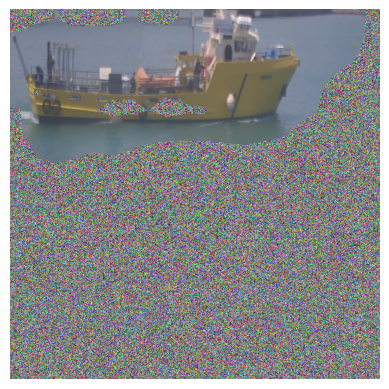


0: 640x640 1 Ferry Boat, 56.1ms
Speed: 3.4ms preprocess, 56.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


75


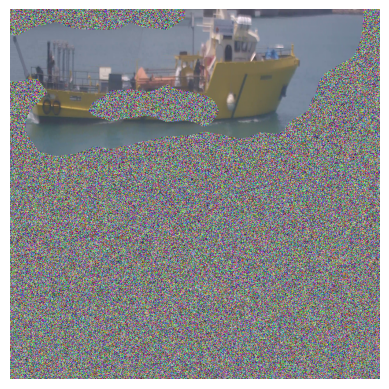


0: 640x640 1 Ferry Boat, 56.2ms
Speed: 3.3ms preprocess, 56.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


80


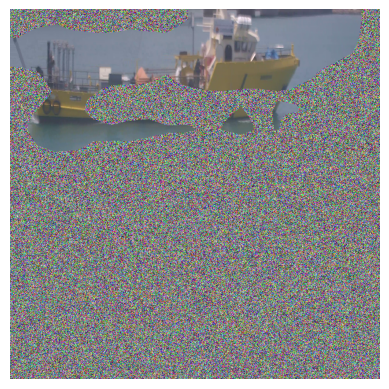


0: 640x640 1 Ferry Boat, 55.8ms
Speed: 3.1ms preprocess, 55.8ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


85


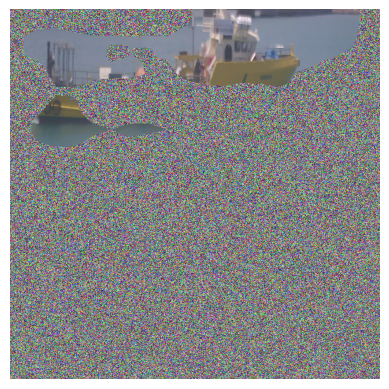


0: 640x640 1 Ferry Boat, 56.5ms
Speed: 3.1ms preprocess, 56.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


90


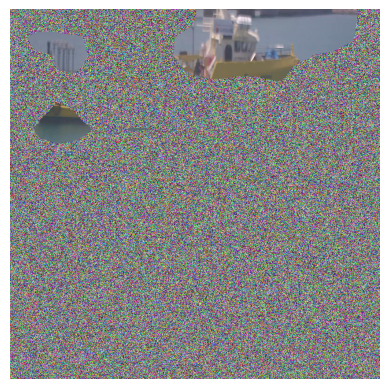


0: 640x640 (no detections), 56.1ms
Speed: 3.4ms preprocess, 56.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


95


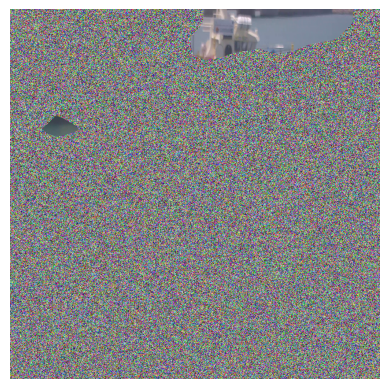


0: 640x640 (no detections), 56.3ms
Speed: 3.2ms preprocess, 56.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


100


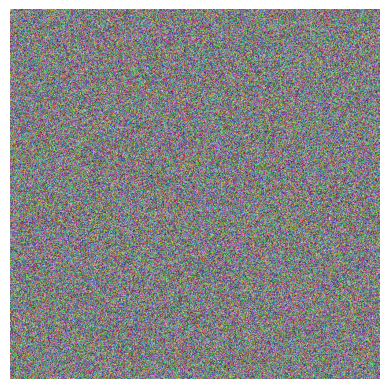

In [9]:
conf_new = []

for i in range (0,101,5):    
    perturbed, _ = replacepixel(rgb_img, g_scale, i, "random")
    results = model(perturbed, verbose=True, classes=0, max_det=1)
    if len(results[0].boxes) != 0:
        conf_new.append(results[0].boxes.conf.cpu().numpy()[0])
    else:
        conf_new.append(0)
    plt.imshow(perturbed)
    print(i)
    plt.axis("off")
    plt.grid("off")
    plt.show()

In [ ]:
conf_new 

[0.72454435,
 0.73015475,
 0.7290041,
 0.72927403,
 0.73039204,
 0.723181,
 0.7353365,
 0.72498685,
 0.7304658,
 0.72856444,
 0.738725,
 0.7072436,
 0.6944251,
 0.6532341,
 0.7658303,
 0.7263168,
 0.61127555,
 0.82004374,
 0.29436845,
 0,
 0]

In [ ]:
dict["conf_tot"]['26-05-2023_16-04-04_Cam2_2967.jpg']

[0.7305810451507568,
 0.7253028750419617,
 0.7288056015968323,
 0.7288890480995178,
 0.7288272976875305,
 0.7278291583061218,
 0.7293827533721924,
 0.730553388595581,
 0.7252243757247925,
 0.7293847799301147,
 0.7336475253105164,
 0.7065954208374023,
 0.691470205783844,
 0.6010485291481018,
 0.7507693767547607,
 0.6272695660591125,
 0.5242048501968384,
 0.8221287727355957,
 0.33410146832466125,
 0,
 0]

In [ ]:
dict = acquire(1)

In [ ]:
image_path = "utils/dataset/subset/01_SpeedBoat/20-04-2023_11-11-57_Cam1_173.jpg"


In [ ]:
dict["initial_conf"]['20-04-2023_11-11-57_Cam1_173.jpg']

0.2536807656288147

In [ ]:
dict["conf_tot"]['20-04-2023_11-11-57_Cam1_173.jpg']

[0.6089916825294495,
 0.8100771903991699,
 0.7180625200271606,
 0.7274503111839294,
 0.6460558772087097,
 0.7811279892921448,
 0.7381389737129211,
 0.76009601354599,
 0.7899977564811707,
 0.690557062625885,
 0.9216116666793823,
 0.691349446773529,
 0.7754740715026855,
 0.896228551864624,
 0.7987377047538757,
 0.7491294741630554,
 0.813541829586029,
 0.7618187665939331,
 0.8228079676628113,
 -1,
 -1]


0: 640x640 1 Speed Boat, 53.9ms
Speed: 3.3ms preprocess, 53.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


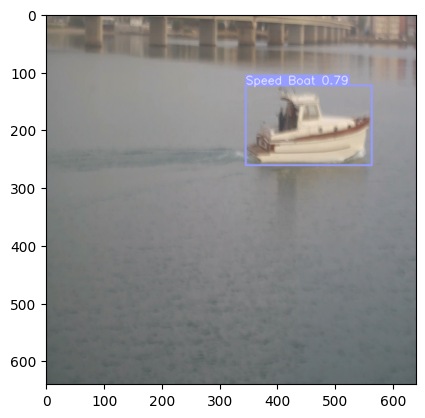

In [ ]:
import cv2
from PIL import Image
from ultralytics import YOLO

img = np.array(Image.open(image_path))
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = img.astype(np.float32) / 255.0
model = YOLO("models/VisibleModel/weights/best.pt")
COLORS = np.random.uniform(0, 255, size=(len(model.names), 3))
results = model(rgb_img, verbose=True, classes=1, max_det=1)
plt.imshow(results[0].plot())



0: 640x640 1 Speed Boat, 54.2ms
Speed: 3.8ms preprocess, 54.2ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


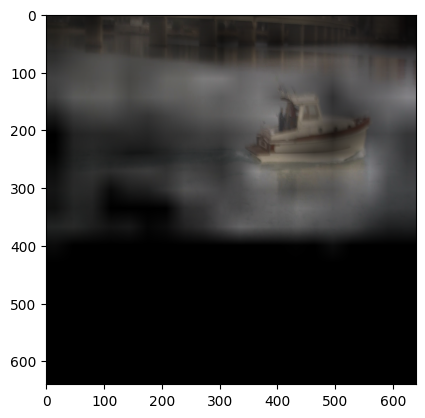

In [ ]:
from yolo_cam.eigen_cam import EigenCAM

target_layers = [model.model.model[-3]]
cam = EigenCAM(model, target_layers)
grayscale_cam = cam(rgb_img)[0, :, :]
g_scale = np.stack([grayscale_cam] * 3, axis=2)
plt.imshow(g_scale/255*rgb_img)



0: 640x640 1 Speed Boat, 56.2ms
Speed: 3.4ms preprocess, 56.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


[    0.64067]


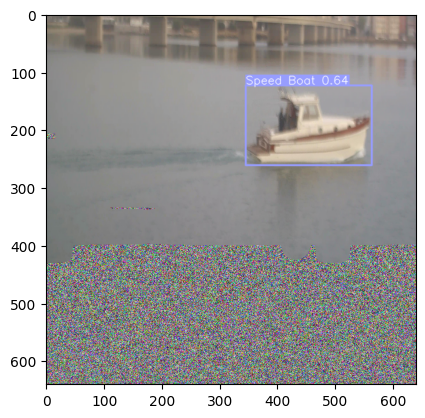


0: 640x640 1 Speed Boat, 56.1ms
Speed: 3.1ms preprocess, 56.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


[    0.59818]


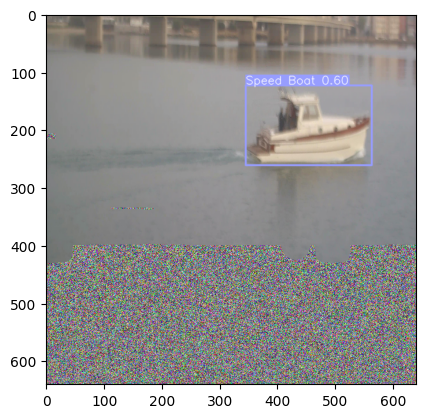


0: 640x640 1 Speed Boat, 56.2ms
Speed: 3.1ms preprocess, 56.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


[    0.61857]


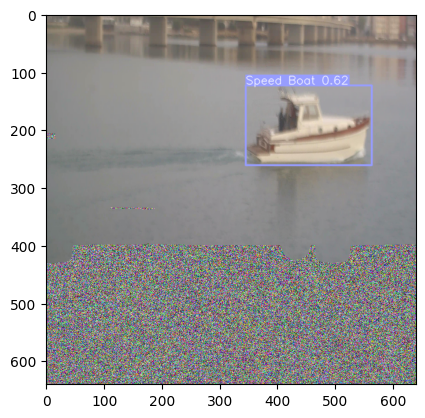


0: 640x640 1 Speed Boat, 55.8ms
Speed: 3.1ms preprocess, 55.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


[    0.60986]


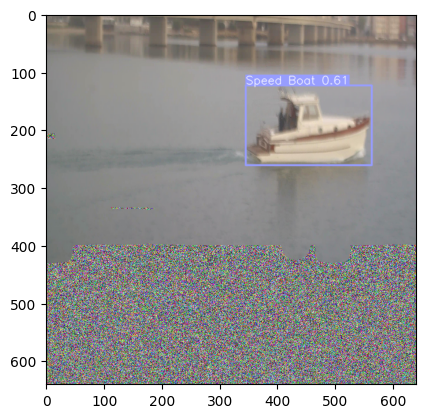


0: 640x640 1 Speed Boat, 56.1ms
Speed: 3.1ms preprocess, 56.1ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


[    0.64831]


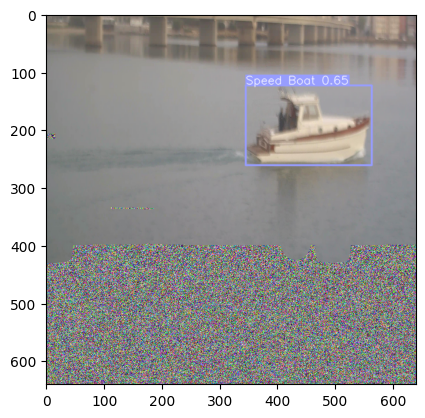


0: 640x640 1 Speed Boat, 56.3ms
Speed: 3.3ms preprocess, 56.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


[     0.6308]


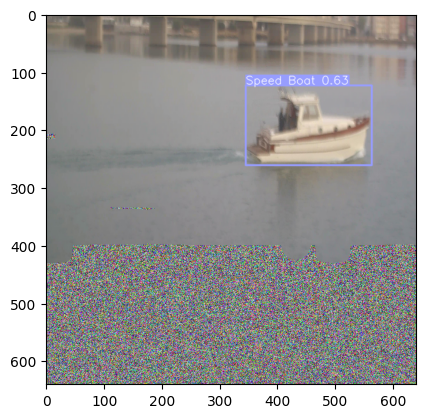


0: 640x640 1 Speed Boat, 55.9ms
Speed: 3.1ms preprocess, 55.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


[    0.61157]


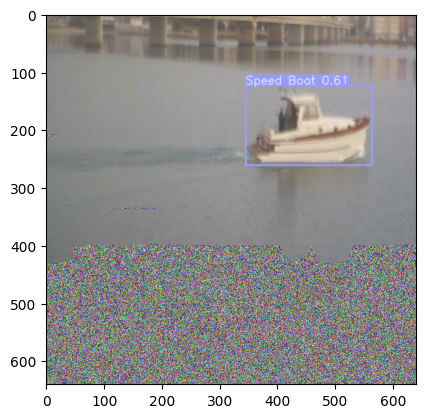


0: 640x640 1 Speed Boat, 55.8ms
Speed: 3.6ms preprocess, 55.8ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


[    0.63611]


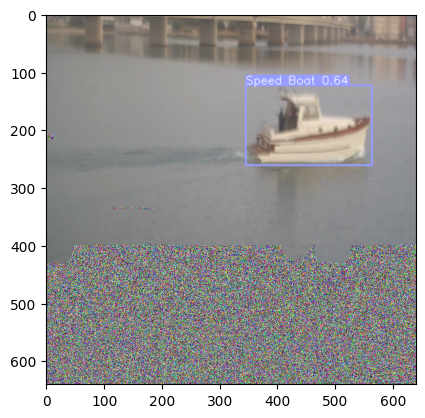


0: 640x640 1 Speed Boat, 56.1ms
Speed: 3.3ms preprocess, 56.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


[       0.55]


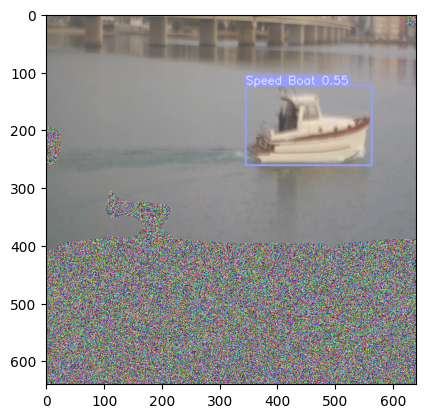


0: 640x640 1 Speed Boat, 56.5ms
Speed: 5.7ms preprocess, 56.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


[    0.44247]


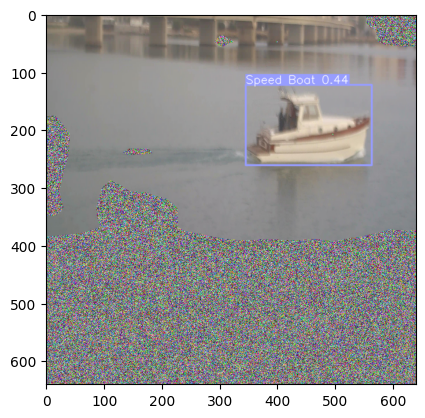


0: 640x640 (no detections), 56.1ms
Speed: 3.1ms preprocess, 56.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


[]


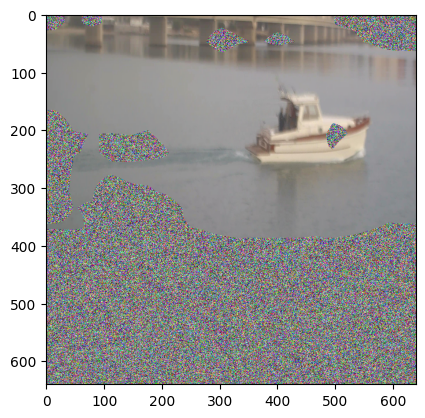


0: 640x640 (no detections), 55.9ms
Speed: 3.5ms preprocess, 55.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


[]


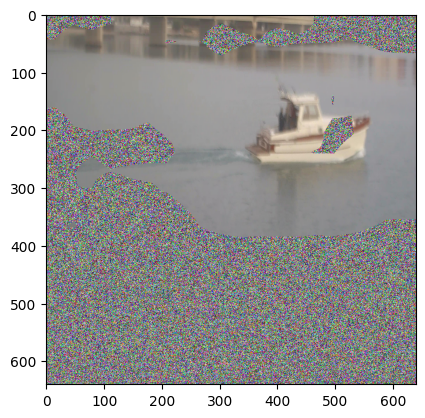


0: 640x640 (no detections), 55.8ms
Speed: 3.4ms preprocess, 55.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


[]


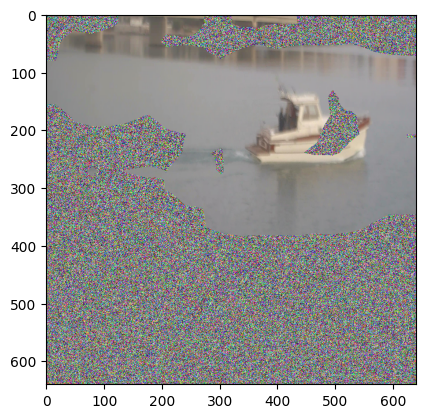


0: 640x640 (no detections), 56.0ms
Speed: 3.3ms preprocess, 56.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


[]


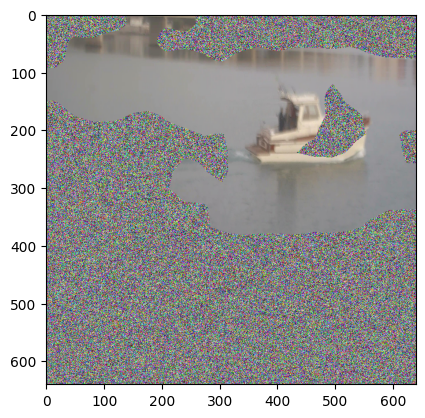


0: 640x640 (no detections), 56.2ms
Speed: 3.2ms preprocess, 56.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


[]


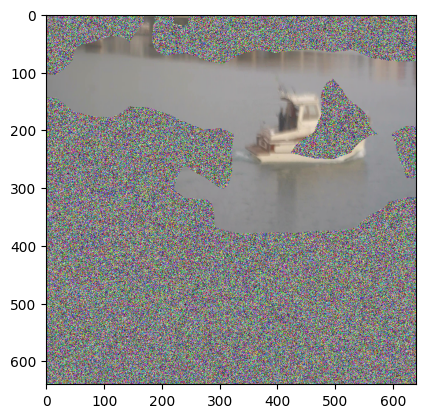


0: 640x640 (no detections), 55.8ms
Speed: 3.4ms preprocess, 55.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


[]


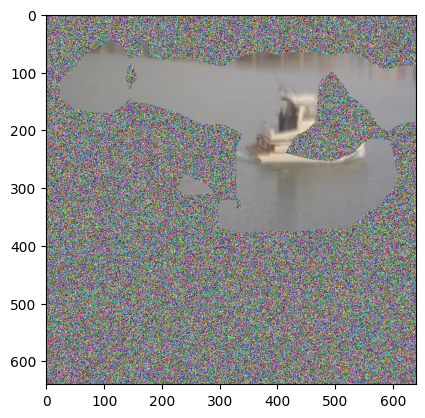


0: 640x640 (no detections), 56.1ms
Speed: 3.2ms preprocess, 56.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


[]


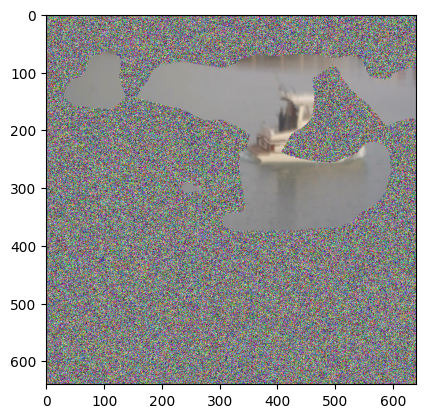


0: 640x640 (no detections), 56.0ms
Speed: 3.3ms preprocess, 56.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


[]


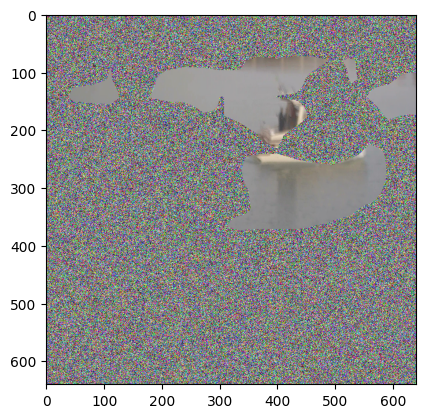


0: 640x640 (no detections), 56.2ms
Speed: 3.4ms preprocess, 56.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


[]


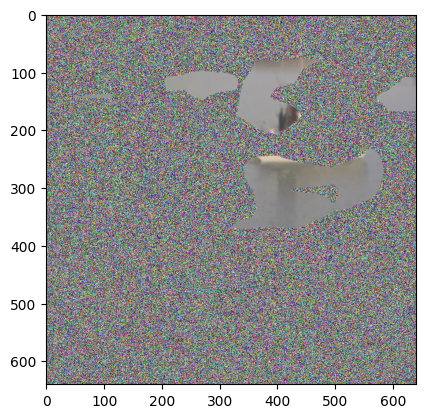


0: 640x640 (no detections), 55.9ms
Speed: 3.1ms preprocess, 55.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


[]


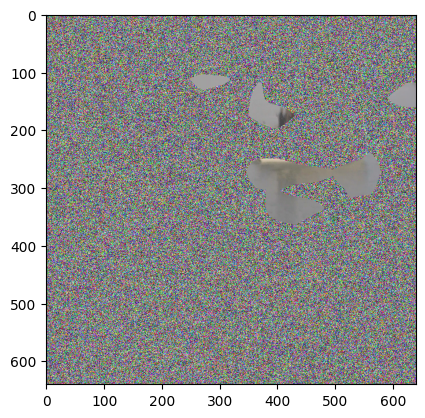


0: 640x640 (no detections), 56.0ms
Speed: 3.3ms preprocess, 56.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


[]


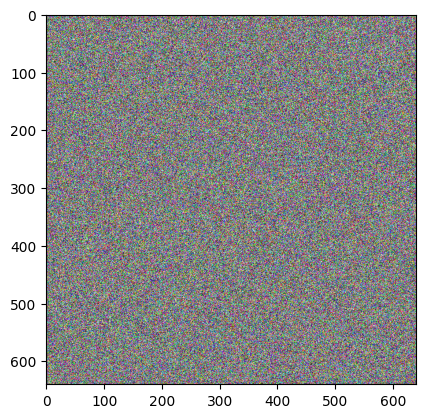

In [ ]:
for i in range (0,101,5):    
    perturbed, _ = replacepixel(rgb_img, g_scale, i, "random")
    results = model(perturbed, verbose=True, classes=1, max_det=1)
    print(results[0].boxes.conf.cpu().numpy())
    plt.imshow(results[0].plot())   
    plt.show()

# HAAS test

In [24]:
cls_0 = acquire_HAAS(0)

In [25]:
def HAAS_test(dict):
    data = dict["initial_conf"]

# Calculate the sum of values and the mean
    values = list(data.values())
    total_sum = sum(values)
    mean = total_sum / len(values)

    print("Len of values:", len(values))
    # print("Mean of values:", mean)

    data_conf = dict["conf_tot"]


    # for key in list(data_conf.keys()):
    #     if key not in data:
    #         del data_conf[key]
    sum_index_0 = 0
    count_index_0 = 0


    for key in data_conf:
        values = data_conf[key]
        if len(values) > 0:
            if values[0] != -1 and values[0] != None:  # Check if the value at index 0 is not -1
                sum_index_0 += values[0]
                count_index_0 += 1
            # else:
            #     sum_index_0 += 0
            #     count_index_0 += 1

    # Calculate the means for index 0 and index 1
    mean_index_0 = sum_index_0 / count_index_0 if count_index_0 > 0 else 0

    # print("Mean of images: ", mean_index_0)
    print("Count", count_index_0)
    return mean, mean_index_0

In [29]:
x_mean = 0
ha_mean = 0

for i in range(6):
    dict = acquire_HAAS(i)
    mean, mean_HA = HAAS_test(dict)
    x_mean = x_mean + mean
    ha_mean = ha_mean + mean_HA
    print("HAAS", x_mean / ha_mean)





Len of values: 186
Count 93
HAAS 1.171346386738626
Len of values: 124
Count 32
HAAS 1.199498228128962
Len of values: 183
Count 45
HAAS 1.2358479903707058
Len of values: 188
Count 115
HAAS 1.2213394817683103
Len of values: 175
Count 128
HAAS 1.2092077196077797
Len of values: 130
Count 58
HAAS 1.2064046381567315


1.2064046381567315

# HAAS

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import preprocessing
import pickle
def acquire_HAAS(x):
    dicts = {}
    files = []
    file_path = "dati/HAAS_trained/"
    data = ["initial_conf_HAAS", "conf_tot_HAAS", "iou_tot_HAAS"]
    for i in range(len(data)):
        files.append(file_path + "0" + str(x) + "_" + str(data[i]) + ".pkl")
    for i,file in enumerate(files):
        with open(file, 'rb') as dict:
            loaded_dict = pickle.load(dict)
            dicts[data[i]] = loaded_dict
    return dicts
def remove_none_HAAS(dict):
    sub_dict = dict["initial_conf_HAAS"]
    for key in sub_dict:
        if sub_dict[key] is None:
            sub_dict[key] = 0
    return sub_dict
def plot_dict_HAAS(dict, cls):
    correct_dict = remove_none_HAAS(dict)
    keys = range(len(list(correct_dict.keys())))
    values = list(correct_dict.values())
    plt.figure(figsize=(15, 10)) 

    plt.bar(keys, values)
    plt.xlabel('Keys')
    plt.ylabel('Confidence')
    plt.title('Confidence level for each image ' + cls)
    plt.show()
def sum_norm_HAAS(dict):
    sum_values = []
    
    for index in range(len(next(iter(dict.values())))):
        index_sum = 0
        valid = True

        for key, value_list in dict.items():
            if not dict[key]:
                index_sum += 0
            else:
                index_sum += value_list[index]

        sum_values.append(index_sum)
    
    min_value = min(sum_values)
    max_value = max(sum_values)

    normalized_values = [(x - min_value) / (max_value - min_value) for x in sum_values]
    return normalized_values
def plot_HAAS(dict, cls, flag):
    step = []
    conf = sum_norm_HAAS(dict["conf_tot_HAAS"])
    iou = sum_norm_HAAS(dict["iou_tot_HAAS"])
    baseline = baseline_conf_HAAS(dict)
    for i in range(0, 101, 5):
        step.append(i)
    if flag:
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7)) 
        ax1.plot(step, conf, label= "Confidence", marker='o', linestyle='-')
        ax1.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
        ax1.legend()
        ax1.grid(True)
        ax1.set_title("Confidence " + cls)
        ax2.plot(step, iou, label= "IoU",marker='o', linestyle='-')
        ax2.set_title("IoU " + cls)
        ax2.grid(True)
    else:
        plt.figure(figsize=(15, 10))  
        plt.plot(step, conf, label= "Confidence", marker='o', linestyle='-')
        plt.axhline(y=baseline, color='r', linestyle='--', label='Baseline')
        plt.legend()
        plt.grid(True)
    plt.tight_layout()
    plt.show()
def find_min_HAAS(dict):
    dict_correct = remove_none_HAAS(dict)
    filtered_values = [value for value in dict_correct.values() if value != 0]
    if filtered_values:
        min_value = min(filtered_values)
        return [key for key, value in dict_correct.items() if value == min_value]
def sort_remove_HAAS(dict):
    dict_correct = remove_none_HAAS(dict)
    return {k: v for k, v in sorted(dict_correct.items(), key=lambda item: item[1]) if v != 0}
def plot_example_HAAS(dict, ex):
    example_inital = dict["initial_conf_HAAS"][ex]
    example = dict["conf_tot_HAAS"][ex]
    for i in range(len(example)):
        if example[i] == -1:
            example[i] = 0
    conf_tot = [x - example_inital for x in example]
    steps = []
    for i in range(0, 101, 5):
        steps.append(i)
    plt.plot(steps, example, label = "Modified", marker='o', linestyle='-')
    plt.axhline(y=example_inital, color='r', linestyle='--', label='Baseline')
    print("Area Over the Perturbation Curve",sum(example) / len(steps))
    plt.legend()
    plt.xlabel('Pixel perturbation')
    plt.ylabel('Confidence')
    plt.title('Confidence vs. Pixel perturbation')
    plt.grid(True) 
    plt.show()
def baseline_conf_HAAS(dict):
    dict_correct = remove_none_HAAS(dict)
    return sum(dict_correct.values()) / len(dict_correct)

In [14]:
cls_1 = acquire_HAAS(1)

In [15]:
cs_1 = acquire(1)

In [16]:
data = cls_1["initial_conf_HAAS"]

for key in data:
    if data[key] is None:
        data[key] = 0

# Calculate the sum of values and the mean
values = list(data.values())
total_sum = sum(values)
mean = total_sum / len(values)

print("Sum of values:", total_sum)
print("Mean of values:", mean)

Sum of values: 114.85664650797844
Mean of values: 0.5742832325398922


In [17]:
data_conf = cls_1["conf_tot_HAAS"]

sum_index_0 = 0
count_index_0 = 0
sum_index_1 = 0
count_index_1 = 0


for key in data_conf:
    values = data_conf[key]
    if len(values) > 0:
        if values[0] != -1:  # Check if the value at index 0 is not -1
            sum_index_0 += values[0]
            count_index_0 += 1
        else:
            sum_index_0 += 0
            count_index_0 += 1
        if values[1] != -1:  # Check if the value at index 1 is not -1
            sum_index_1 += values[1]
            count_index_1 += 1
        else:
            sum_index_1 += 0
            count_index_1 += 1

# Calculate the means for index 0 and index 1
mean_index_0 = sum_index_0 / count_index_0 if count_index_0 > 0 else 0
mean_index_1 = sum_index_1 / count_index_1 if count_index_1 > 0 else 0

print("Mean of images: ", mean_index_0)
print("Count", count_index_0)

Mean of images:  0.4629768435843289
Count 128


In [19]:
mean / mean_index_0

1.2404145919995444

In [ ]:
mean_index_1 / mean

1.3444892695805628

# Heatmaps

In [ ]:
file = "dati/00_layers.pkl" 
heatmap= {}     
with open(file, 'rb') as file:
    heatmap = pickle.load(file)


In [ ]:
heatmap.keys()

dict_keys(['16-05-2023_13-52-59_Cam4_292.jpg', '25-05-2023_12-03-36_Cam2_1414.jpg', '16-05-2023_13-52-59_Cam2_300.jpg', '16-05-2023_13-52-59_Cam4_268.jpg', '03-05-2023_19-15-45_Cam1_206.jpg'])

In [ ]:
from PIL import Image
import cv2

image_path = "utils/dataset/subset/00_FerryBoat/03-05-2023_19-15-45_Cam1_206.jpg"
img = np.array(Image.open(image_path))
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = img.astype(np.float32) / 255.0

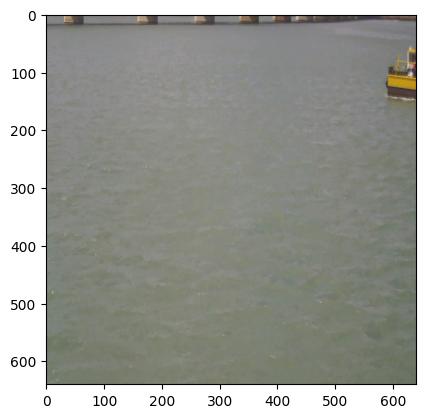

In [ ]:
plt.imshow(img)

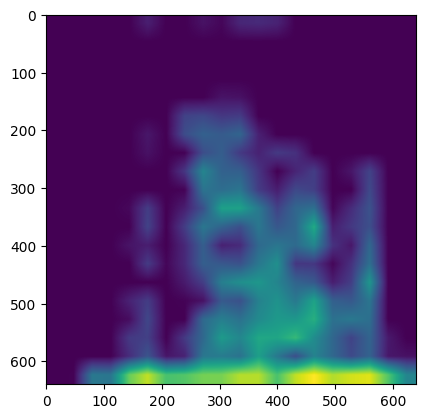

In [ ]:
plt.imshow(heatmap['03-05-2023_19-15-45_Cam1_206.jpg'][-1])